In [2]:
PROJECT_FOLDER = "/data/students_home/amoscatelli/Desktop/actionAnalysis"
# PROJECT_FOLDER = "/Users/andrea/Documents/universita/tesi"

SCENE_FOLDER_PATH = PROJECT_FOLDER + "/scenes/"
SCENE_POSES_FOLDER_PATH = SCENE_FOLDER_PATH + "poses/"
INPUT_SCENE_FOLDER_PATH = SCENE_FOLDER_PATH + "input_video/"
SCENE_DATASET_FOLDER_PATH = SCENE_FOLDER_PATH + "dataset/"
OUTPUT_SCENE_FOLDER_PATH = SCENE_FOLDER_PATH + "output_video/"
SCENE_WITH_POSE_FOLDER_PATH = OUTPUT_SCENE_FOLDER_PATH + "poses_on_video/"
INFERENCE_MODEL_FOLDER_PATH = SCENE_FOLDER_PATH + "model/"

In [2]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "2"

In [3]:
import numpy as np
import tensorflow as tf
import random as rn
from keras import backend as K
import os
session_conf = tf.ConfigProto(intra_op_parallelism_threads=32, inter_op_parallelism_threads=32)
# session_conf = tf.ConfigProto()
session_conf.gpu_options.allow_growth = True

sess = tf.Session(graph=tf.get_default_graph(), config=session_conf)
K.set_session(sess)

/data/students_home/amoscatelli/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:541: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/data/students_home/amoscatelli/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:542: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/data/students_home/amoscatelli/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:543: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/data/student

In [5]:
from os.path import isfile, isdir, join, exists
import cv2
from PIL import Image

# extracting the frames of the passed video file name in output_folder
def extractFrames(filePath, output_folder, REQUESTED_FRAMES_PER_SECONDS = 9999999, rotate = 0):

    # Opens the Video file
    video = cv2.VideoCapture(filePath)

    fps = round(video.get(cv2.CAP_PROP_FPS))
    length = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    width  = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

    print("Original FPS: {}".format(int(fps)))
    print("Requested FPS: {}".format(int(REQUESTED_FRAMES_PER_SECONDS)))
    print("length: {} width: {} height: {}".format(length, width, height))
    frame_ratio_to_keep = max(round(fps/REQUESTED_FRAMES_PER_SECONDS),1)

    print("pick 1 frame every {}".format(int(frame_ratio_to_keep)))

    if not exists(output_folder):
        !mkdir $output_folder
#     try:
#         os.mkdir(output_folder)
#     except:
#         pass

    !rm $output_folder/* # cleaning output_folder

    i = -1
    while(video.isOpened()):
        i+=1
        ret, frame = video.read()
        if(i%frame_ratio_to_keep!=0):
            # print("DISCARDED")
            continue
        # print("PASSED")
        if ret == False:
            # print("FINISHED")
            break
        outputFramePath = join(output_folder,"frame{:04d}.jpg".format(i))
        cv2.imwrite(outputFramePath, frame)
        if rotate > 0:
            rotated = Image.open(outputFramePath).rotate(rotate)
            rotated.save(outputFramePath)

    video.release()
    cv2.destroyAllWindows()
    
    return fps, width, height


In [2]:
# import os
# os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
# os.environ["CUDA_VISIBLE_DEVICES"] = "2"

In [3]:
# import numpy as np
# import tensorflow as tf
# import random as rn
# from keras import backend as K
# import os
# session_conf = tf.ConfigProto(intra_op_parallelism_threads=32, inter_op_parallelism_threads=32)
# # session_conf = tf.ConfigProto()
# session_conf.gpu_options.allow_growth = True

# sess = tf.Session(graph=tf.get_default_graph(), config=session_conf)
# K.set_session(sess)

KeyboardInterrupt: 

In [3]:
# sceneFileList = [f for f in scandir(INPUT_SCENE_FOLDER_PATH)]
# temp_folder = SCENE_FOLDER_PATH + "temp_extraction_frames/"
# filePath = sceneFileList[5].path
# filePath
# # extractFrames(filePath, temp_folder)  
# # # extractFrames(sceneFile.path,temp_folder,rotate=180)

# # Opens the Video file
# video = cv2.VideoCapture(filePath)

# fps = round(video.get(cv2.CAP_PROP_FPS))
# length = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
# width  = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
# height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

# print("Original FPS: {}".format(int(fps)))
# print("Requested FPS: {}".format(int(REQUESTED_FRAMES_PER_SECONDS)))
# print("length: {} width: {} height: {}".format(length, width, height))


In [26]:
# sceneFileList[5].path

# Extracting poses from scenes

In [4]:
import pickle
import torch, torchvision
print(torch.__version__)
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
#from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

1.4.0+cu100


In [10]:
# from os import listdir, scandir
# sceneFileList = [f for f in scandir(INPUT_SCENE_FOLDER_PATH)]

In [6]:
# sceneFile = sceneFileList[0]
# sceneFile.path

In [7]:
# sceneFileList[0].path

In [8]:
# temp_folder = SCENE_FOLDER_PATH + "temp_extraction_frames/"
# framePaths = [f.path for f in os.scandir(temp_folder) if f.is_file() and f.path.endswith('.jpg')]
# framePaths[0]

In [7]:
# import sys 
from os import listdir, scandir

sceneFileList = [f for f in scandir(INPUT_SCENE_FOLDER_PATH)]

#### PoseNet config #### 
poseNetModel = 101 #50, 75, 100, 101

#### Detectron2 config #### 
cfg = get_cfg()
detectron2ConfigName = "/detectron2_repo/configs/COCO-Keypoints/keypoint_rcnn_X_101_32x8d_FPN_3x.yaml"
modelWeightName = "detectron2://COCO-Keypoints/keypoint_rcnn_X_101_32x8d_FPN_3x/139686956/model_final_5ad38f.pkl"
# detectron2ConfigName = "/detectron2_repo/configs/COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"
# modelWeightsName = "detectron2://COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x/137849621/model_final_a6e10b.pkl"
cfg.merge_from_file(PROJECT_FOLDER+detectron2ConfigName)
cfg.MODEL.WEIGHTS = modelWeightName
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4  # set threshold for this model

predictor = DefaultPredictor(cfg) # Detectron2 predictor

for idx_scene,sceneFile in enumerate(sceneFileList):
    print("#### {} / {} - {} ###".format(idx_scene+1,len(sceneFileList),sceneFile.name))    
    video_points_folder_name = SCENE_POSES_FOLDER_PATH+sceneFile.name[:-4]
    
    if not exists(video_points_folder_name):
        os.mkdir(video_points_folder_name)
    else:
        continue
    
    
#     ######### Extracting frames #########
    temp_folder = SCENE_FOLDER_PATH + "temp_extraction_frames/"
    extractFrames(sceneFile.path,temp_folder,rotate=180) # extract the video frames in temp_folder
    framePaths = [f.path for f in os.scandir(temp_folder) if f.is_file() and f.path.endswith('.jpg')]
    
    ######### POSENET #########
    poseNetFolder = video_points_folder_name+"/PoseNet-"+str(poseNetModel)
    if not exists(poseNetFolder):
        os.mkdir(poseNetFolder)
    #         !export CUDA_VISIBLE_DEVICES=$GPU_CARD && 
        !cd $PROJECT_FOLDER/posenet-python && python keyPointsLogger.py \
            --model $poseNetModel \
            --image_dir $temp_folder \
            --output_dir $poseNetFolder
    else:
        print("######  video already parsed with PoseNet #####")

    print("######  PoseNet done  #####")


    ######### Detectron2 #########
    print("######  parsing with Detectron2.... #####")
    detectron2Model = detectron2ConfigName.split("/")[-1][:-5]
    detectron2Folder = video_points_folder_name+"/Detectron2-"+str(detectron2Model)
    if not exists(detectron2Folder):
        os.mkdir(detectron2Folder)
        for frame_path in framePaths:
            outputsFile = frame_path.split("/")[-1][:-4]+".pickle" # e.g.: ./temp/frame0010.jpg --> frame0010.pickle
            im = cv2.imread(frame_path)      
            outputs = predictor(im)
            with open(detectron2Folder+"/"+outputsFile, 'wb') as file_out:
                pickle.dump(outputs, file_out, protocol=pickle.HIGHEST_PROTOCOL)
    else:
        print("######  video already parsed with Detectron2 #####")

    print("######  Detectron2 done! #####")

#### 0 / 19 - 1-8.mp4 ###
#### 1 / 19 - 1-11.mp4 ###
#### 2 / 19 - 1-7.mp4 ###
#### 3 / 19 - 1-4.mp4 ###
#### 4 / 19 - 1-3.mp4 ###
#### 5 / 19 - 3-4.mov ###
#### 6 / 19 - 1-5.mp4 ###
#### 7 / 19 - 3-3.mov ###
#### 8 / 19 - 2-1.mov ###
#### 9 / 19 - 1-2.mp4 ###
#### 10 / 19 - 1-9.mp4 ###
#### 11 / 19 - 1-10.mp4 ###
#### 12 / 19 - 1-1.mp4 ###
#### 13 / 19 - 2-3.mov ###
#### 14 / 19 - 3-1.mov ###
#### 15 / 19 - 2-2.mov ###
#### 16 / 19 - 3-2.mov ###
#### 17 / 19 - 3-5.mov ###
#### 18 / 19 - 1-6.mp4 ###


# Creating Dataset

In [9]:
from scipy.spatial import distance

def extractBestPosesAlongTheVideoOLD(pose_scores_video, keypoint_coords_video, numberOfPosesToExtract):
    numberOfDetectedPeople = max([np.count_nonzero(i) for i in pose_scores_video])
    alignedCoords = np.zeros((len(pose_scores_video), numberOfDetectedPeople, 17, 2))
    alignedPoseScores = np.zeros((len(pose_scores_video), numberOfDetectedPeople))
    #     peopleLastCoords = keypoint_coords_video[0][:numberOfDetectedPeople]
    peopleLastCoords = np.zeros((numberOfDetectedPeople,17,2))
    for frame_idx, frame in enumerate(keypoint_coords_video):
        coordDistances = [] #triplet list -> distance, id_new_coords, id_person
        for newCoords_idx, newCoords in enumerate(frame):
            if np.count_nonzero(newCoords) == 0: # skip all the coords which are just zeros
                continue
            for person_idx, personLastCoords in enumerate(peopleLastCoords):
                coordinatesDistance = np.mean([distance.euclidean(newCoords[i],personLastCoords[i]) 
                                           for i in range(len(newCoords))
                                           if np.count_nonzero(newCoords[i]) == 2 
                                           and np.count_nonzero(personLastCoords[i]) == 2])
                # in case of poses which are all 0's
                if np.isnan(coordinatesDistance): 
                    coordinatesDistance = float("inf")

                coordDistances.append((coordinatesDistance,newCoords_idx,person_idx))

        # sort distances from te closest to the farest
        coordDistances.sort(key=lambda x : x[0]) 

        idNewCoords = [None for i in range(numberOfDetectedPeople)]
        for distance_triplet in coordDistances:
            person_idx = distance_triplet[2]
            newCoords_idx = distance_triplet[1]
            # check that the person doesn't have already a new coord and that the new coords are not already used  
            if idNewCoords[person_idx] == None and newCoords_idx not in idNewCoords:
                # assign new closest coords to people
                idNewCoords[person_idx] = newCoords_idx
                alignedCoords[frame_idx][person_idx] = frame[newCoords_idx]
                peopleLastCoords[person_idx] = frame[newCoords_idx]
                alignedPoseScores[frame_idx][person_idx] = pose_scores_video[frame_idx][newCoords_idx]


        # for the people who didn't find a match in the new coordinates we add a bunch of zeros in the result
        # without updating their last coordinates
        for person_idx, value in enumerate(idNewCoords):
            if value == None:
                alignedCoords[frame_idx][person_idx] = np.zeros((17,2))
                alignedPoseScores[frame_idx][person_idx] = 0


    # select the best poses
    scorePosesRank = np.mean(alignedPoseScores, axis=0)
    posesIndexRank = scorePosesRank.argsort()[::-1]

    isSecondPersonDetected = True
    if numberOfPosesToExtract == 1:
        bestPoseKeypointCoords = alignedCoords[:,posesIndexRank[0]]
    elif numberOfPosesToExtract == 2:
        if len(posesIndexRank) == 1:
            isSecondPersonDetected = False
            bestPoseKeypointCoords = np.concatenate((
                                                    alignedCoords[:,posesIndexRank[0]], 
                                                    np.zeros( #concatenate it with a bunch of zeros whit the same shape
                                                        alignedCoords[:,posesIndexRank[0]].shape
                                                    )),axis=1)
        else:
            bestPoseKeypointCoords = np.concatenate((
                                                    alignedCoords[:,posesIndexRank[0]], 
                                                    alignedCoords[:,posesIndexRank[1]]
                                                    ),axis=1)
    else:
        raise Exception("So far, it's possible to extract maximum 2 people from the video.") 

    return bestPoseKeypointCoords, isSecondPersonDetected


In [114]:
# New version
# pose_scores_video, keypoint_coords_video, numberOfPosesToExtract
#     xAxisIndex = 0
def extractBestPosesAlongTheVideo(pose_scores_video, keypoint_coords_video, numberOfPosesToExtract, xAxisIndex = 0):
    bestPosesOfVideo = np.zeros((len(pose_scores_video), numberOfPosesToExtract*17, 2), dtype=np.float32)
    peopleDetected = 0
    for idx_frame in range(len(pose_scores_video)):
        if np.count_nonzero(keypoint_coords_video[idx_frame]) == 0:
            bestPosesList = [np.zeros((17,2), dtype=np.float32)]
        else:
            # select best poses indexes
            indexBestPoses = np.asarray(pose_scores_video[idx_frame]).argsort()[::-1][:numberOfPosesToExtract]

            #extracting best poses
            bestPosesList = [keypoint_coords_video[idx_frame][idx_best_pose] for idx_best_pose in indexBestPoses]
            
        for missing in range(len(bestPosesList),numberOfPosesToExtract):
            bestPosesList.append(np.zeros((17,2), dtype=np.float32))
        # bestPoses = list(keypoint_coords_video[idx_frame][indexBestPoses])

        # sorting poses by mean X posistion
        bestPosesList.sort(key=lambda x: np.mean(x,axis=0)[xAxisIndex],reverse=True)

        bestPoses = np.asarray(bestPosesList)
        bestPoses = np.concatenate(bestPoses,axis=0)

        # append best poses
        bestPosesOfVideo[idx_frame] = bestPoses
        peopleDetected = max(peopleDetected,len(bestPoses))
    
    return bestPosesOfVideo, peopleDetected >= numberOfPosesToExtract

In [77]:
# # bestPosesOfVideo.shape
# xAxisIndex = 0
# idx_frame = 315
# indexBestPoses = pose_scores_video[idx_frame].argsort()[::-1][:numberOfPosesToExtract]
        
# #extracting best poses
# bestPosesList = [keypoint_coords_video[idx_frame][idx_best_pose] for idx_best_pose in indexBestPoses]
# for missing in range(len(bestPosesList),numberOfPosesToExtract):
#     bestPosesList.append(np.zeros((17,2)))
# # bestPoses = list(keypoint_coords_video[idx_frame][indexBestPoses])

# # sorting poses by mean X posistion
# bestPosesList.sort(key=lambda x: np.mean(x,axis=0)[xAxisIndex],reverse=True)
# bestPoses = np.asarray(bestPosesList)

In [81]:
# np.concatenate(bestPoses,axis=0).shape
# indexBestPoses,len(bestPosesList),bestPosesList

In [107]:
# bestPosesOfVideo, peopleDetected  = extractBestPosesAlongTheVideo(pose_scores_video, keypoint_coords_video, numberOfPosesToExtract, xAxisIndex = 0)

In [108]:
# bestPosesOfVideo[315].shape

In [4]:
# pose_scores_video[0]

## PoseNet

In [113]:
from os import scandir, listdir
from os.path import basename

def getPoseNetResult(inputFolder = "/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/poses/", poseNetModelName = "PoseNet-101"):
    print("retrieving PoseNet points from input folders...")
    videoFeaturesList = []
    videoNameList = []

    videoFoldersToAnalyse = [f.path for f in scandir(inputFolder) if isdir(join(inputFolder, f))]

    print("found {} folders for {}".format(len(videoFoldersToAnalyse), poseNetModelName))
    for i,avf in enumerate(videoFoldersToAnalyse):
        print("{}/{} - {}".format(i+1, len(videoFoldersToAnalyse),basename(avf)))

        poseNet_folder = avf + "/"+ poseNetModelName
        pose_scores_video = []
    #     keypoint_scores_video = [] # ignoring for now
        keypoint_coords_video = []
        framesInFolder = [f for f in listdir(poseNet_folder) if f.endswith(".pickle")]
        framesInFolder.sort() # must be sorted to have the frame in the correct order   
        for frame_file in framesInFolder:
            with open(poseNet_folder+"/"+frame_file,'rb') as file_in:
                pose_scores, keypoint_scores, keypoint_coords = pickle.load(file_in)
            pose_scores_video.append(pose_scores)
    #         keypoint_scores_video.append(keypoint_scores) # for now ignoring the keypoints Scores
            keypoint_coords_video.append(keypoint_coords)

#         numberOfPosesToExtract = 1 if target < 50 else 2
        numberOfPosesToExtract = 2

        bestPosesKeypointCoords, isSecondPersonDetected = extractBestPosesAlongTheVideo(pose_scores_video, 
                                                                keypoint_coords_video, 
                                                                numberOfPosesToExtract,xAxisIndex=1)

        if not isSecondPersonDetected:
            print("The second person is not recognized in the whole video:", basename(avf))


        videoFeaturesList.append(bestPosesKeypointCoords)
        videoNameList.append(basename(avf))


    # converting to ndarray
    videoFeatures = np.asarray(videoFeaturesList)
    videoNames = np.asarray(videoNameList)

    # final assertion (just to be sure)
    assert len(videoFeatures) == len(videoNames)

    return videoFeatures,videoNames

## Detectron

In [93]:
# type(np.zeros((2,2), dtype=np.float16)[0][0])

numpy.float16

In [105]:
# min_value = np.finfo(np.float32).min
# max_value = np.finfo(np.float32).max
# max_precision = np.finfo(np.float32).precision
# min_value,max_value,max_precision

(-3.4028235e+38, 3.4028235e+38, 6)

In [108]:
# inputFolder = "/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/poses/"
# [f.path for f in scandir(inputFolder) if isdir(join(inputFolder, f))]
featuresNew, namesNew = getDetectronResult()

retrieving detectron points from input folders...
##### OCCHIO STAI SCANSIONANDO SOLO 3-3!!!
found 1 folders for keypoint_rcnn_X_101_32x8d_FPN_3x
1/1 - 3-3


In [16]:
featuresOld, namesOld = getDetectronResult()

retrieving detectron points from input folders...
##### OCCHIO STAI SCANSIONANDO SOLO 3-3!!!
found 1 folders for keypoint_rcnn_X_101_32x8d_FPN_3x
1/1 - 3-3


In [110]:
# type(featuresNew[0][0][0][0]), type(featuresOld[0][0][0][0]),featuresNew.shape, featuresOld.shape, featuresNew[0][0],featuresOld[0][0]

In [115]:
def getDetectronResult(inputFolder = "/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/poses/", detectron2ModelName = "keypoint_rcnn_X_101_32x8d_FPN_3x"):
    print("retrieving detectron points from input folders...")
    videoFeaturesList = []
    videoNameList = []
    
    videoFoldersToAnalyse = [f.path for f in scandir(inputFolder) if isdir(join(inputFolder, f))]
#     print("##### OCCHIO STAI SCANSIONANDO SOLO 3-3!!!")

    print("found {} folders for {}".format(len(videoFoldersToAnalyse), detectron2ModelName))

    for i, avf in enumerate(videoFoldersToAnalyse):
        print("{}/{} - {}".format(i+1, len(videoFoldersToAnalyse), basename(avf)))

        detectron2_folder = avf + "/Detectron2-"+ detectron2ModelName
        framesInFolder = [f for f in listdir(detectron2_folder) if f.endswith(".pickle")]
        framesInFolder.sort() # must be sorted to have the frame in the correct order   
        keypoint_coords_video = []
        pose_scores_video = []

        for fIdx,frame_file in enumerate(framesInFolder):
            with open(detectron2_folder+"/"+frame_file,'rb') as file_in:
                outputsRead = pickle.load(file_in)

            if len(outputsRead['instances']) == 0:
                # in case of no pose is detected we fill the features with zeros
                keypoints_frame = np.zeros((17,2))
                score_poses = [0]
                print(" for video {}-{} the frame {} is filled with zeros".format(i,basename(avf),fIdx))
            else:
                instancesDict = outputsRead['instances'].get_fields()
                keypoints_frame = np.array(instancesDict['pred_keypoints'].cpu()) 
                keypoints_frame = np.delete(keypoints_frame, 2, 2) #removing the third value of each keypoint (which I still don't understand what it means)
                score_poses = np.array(instancesDict['scores'].cpu()) 

            keypoint_coords_video.append(keypoints_frame)
            pose_scores_video.append(score_poses)


#         numberOfPosesToExtract = 1 if target < 50 else 2
        numberOfPosesToExtract = 2
        
        bestPoses, isSecondPersonDetected = extractBestPosesAlongTheVideo(
            pose_scores_video, keypoint_coords_video, numberOfPosesToExtract
        )
        
        
        if not isSecondPersonDetected:
            print("The second person is not recognized in the whole video:", basename(avf))
            

        videoFeaturesList.append(bestPoses)
        videoNameList.append(basename(avf))

    # converting to ndarray
    videoFeatures = np.asarray(videoFeaturesList)
    videoNames = np.asarray(videoNameList)

    #final assertion (just to be sure)
    assert len(videoFeatures) == len(videoNames)

    return videoFeatures,videoNames

In [24]:
# detectron2_folder = "/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/poses/"+ "3-3" + "/Detectron2-"+ "keypoint_rcnn_X_101_32x8d_FPN_3x"
# framesInFolder = [f for f in listdir(detectron2_folder) if f.endswith(".pickle")]
# framesInFolder

In [116]:
import pickle
import numpy as np

modelNames = ["keypoint_rcnn_X_101_32x8d_FPN_3x"
              ,"PoseNet-101"
             ]
for modelName in modelNames:
    if modelName == "PoseNet-101":
        videoFeatures,videoNames = getPoseNetResult()
    elif modelName == "keypoint_rcnn_X_101_32x8d_FPN_3x":
        videoFeatures,videoNames = getDetectronResult()
    else:
        raise Exception("model name {} unknown".format(modelName)) 
        
    datasetResultName = SCENE_DATASET_FOLDER_PATH+modelName+"-SCENES-dataset.pickle"
    print("Dumping the result in ",datasetResultName)
    with open(datasetResultName, 'wb') as handle:
        pickle.dump((videoFeatures,videoNames), handle, protocol=pickle.HIGHEST_PROTOCOL)    
print("DONE")

retrieving detectron points from input folders...
found 19 folders for keypoint_rcnn_X_101_32x8d_FPN_3x
1/19 - 3-3
2/19 - 3-1
3/19 - 2-1
4/19 - 1-5
5/19 - 2-3
6/19 - 1-10
7/19 - 3-2
8/19 - 1-9
9/19 - 2-2
10/19 - 1-8
11/19 - 1-3
12/19 - 3-5
13/19 - 1-1
14/19 - 1-4
15/19 - 1-11
16/19 - 1-2
17/19 - 3-4
18/19 - 1-7
19/19 - 1-6
Dumping the result in  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-dataset.pickle
retrieving PoseNet points from input folders...
found 19 folders for PoseNet-101
1/19 - 3-3
2/19 - 3-1
3/19 - 2-1
4/19 - 1-5
5/19 - 2-3
6/19 - 1-10
7/19 - 3-2
8/19 - 1-9
9/19 - 2-2
10/19 - 1-8
11/19 - 1-3
12/19 - 3-5
13/19 - 1-1
14/19 - 1-4
15/19 - 1-11
16/19 - 1-2
17/19 - 3-4
18/19 - 1-7
19/19 - 1-6
Dumping the result in  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/PoseNet-101-SCENES-dataset.pickle
DONE


# Cleaning dataset

In [7]:
import pickle
modelToLoad = "keypoint_rcnn_X_101_32x8d_FPN_3x"
# modelToLoad = "PoseNet-101"

datasetToLoad = SCENE_DATASET_FOLDER_PATH + modelToLoad + "-SCENES-dataset.pickle"
# datasetToLoad = SCENE_DATASET_FOLDER_PATH + modelToLoad + "-SCENES-CLEANED-dataset.pickle"

print("Reading ", datasetToLoad)
with open(datasetToLoad,'rb') as file_in:
    readFeatures, readNames = pickle.load(file_in)

Reading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-dataset.pickle


DONE!


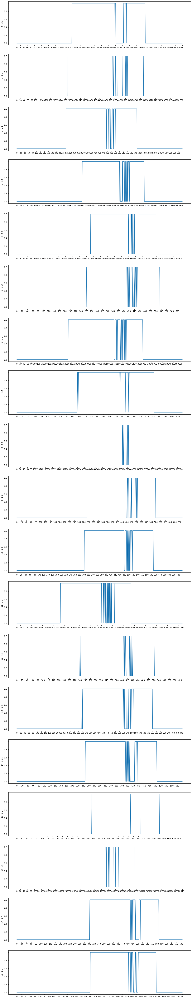

In [10]:
from pandas import Series
import numpy as np
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
fig, axes = plt.subplots(nrows=len(readFeatures), ncols=1)
fig.set_size_inches((17,len(readFeatures)*5))
# plt.xticks(rotation=45)
for idx_video, video in enumerate(readFeatures):
#     print("### video {} ###".format(readNames[idx_video]))
    y = [1 if np.count_nonzero(video[i][17:]) == 0 else 2 for i in range(len(video))]
    ts = Series(y, index=list(range(len(video))))
    axes[idx_video].set_ylabel("{} - {}".format(idx_video,readNames[idx_video]))
    axes[idx_video].set_xticks(range(0,len(video),20))
#     axes[idx_video].tick_params(axis='x', labelrotation=90 ) 
#     axes[idx_video].set_xticklabels([str(i) for i in range(0,len(video),10)],rotation='vertical')
#     axes[idx_video].xticks(rotation=90)
    ts.plot(ax=axes[idx_video])
print("DONE!")

In [9]:
cleanings = [
    #idx_video, (fromFrame,toFrame),POSE_TO_KEEP]
    (4,(860,901),2),
    (7,(445,446),2),
    (9,(200,210),2),
    (11,(780,785),2),
    (12,(550,580),1),
    (12,(160,226),1),
    (13,(210,308),1),
    (14,(510,511),2)
  ]

# plt.figure(figsize=(17,5))
for idx_video, (fromFrame,toFrame), POSE_TO_KEEP in cleanings:
    print("video", idx_video)
    cleanFeatures = readFeatures[idx_video]
    for i in range(fromFrame,toFrame):
        secondPosePresent = np.count_nonzero(cleanFeatures[i][17:]) != 0
        if POSE_TO_KEEP == 1 and secondPosePresent:
            print("REMOVED second pose at frame",i)
    #         cleanFeatures[i][:17] = cleanFeatures[i][17:]
            cleanFeatures[i][17:] = np.zeros((17,2))

        elif POSE_TO_KEEP == 2 and secondPosePresent:
            print("REPLACED first pose with second at frame",i) 
            cleanFeatures[i][:17] = cleanFeatures[i][17:]
            cleanFeatures[i][17:] = np.zeros((17,2))

    # for idx_video, video in enumerate(readFeatures):
    #     print("### video {} ###".format(readNames[idx_video]))
    # y = [1 if np.count_nonzero(cleanFeatures[i][17:]) == 0 else 2 for i in range(len(cleanFeatures))]
    # ts = Series(y, index=list(range(len(cleanFeatures))))
    # plt.ylabel("{} - {}".format(idx_video,readNames[idx_video]))
    # plt.xticks(range(0,len(cleanFeatures),50))
    # ts.plot()
print("DONE!")
# readFeatures[idx_video] = cleanFeatures

video 4
REPLACED first pose with second at frame 880
REPLACED first pose with second at frame 883
REPLACED first pose with second at frame 884
REPLACED first pose with second at frame 885
REPLACED first pose with second at frame 886
REPLACED first pose with second at frame 887
REPLACED first pose with second at frame 888
REPLACED first pose with second at frame 889
REPLACED first pose with second at frame 890
video 7
REPLACED first pose with second at frame 445
video 9
REPLACED first pose with second at frame 206
video 11
REPLACED first pose with second at frame 783
REPLACED first pose with second at frame 784
video 12
REMOVED second pose at frame 564
REMOVED second pose at frame 567
REMOVED second pose at frame 569
REMOVED second pose at frame 570
REMOVED second pose at frame 573
video 12
REMOVED second pose at frame 169
REMOVED second pose at frame 170
REMOVED second pose at frame 171
REMOVED second pose at frame 172
REMOVED second pose at frame 173
REMOVED second pose at frame 174
R

In [11]:
# datasetToSave = SCENE_DATASET_FOLDER_PATH + modelToLoad + "-SCENES-CLEANED-dataset.pickle"

# print("Saving cleaned dataset", datasetToSave)
# with open(datasetToSave, 'wb') as handle:
#         pickle.dump((readFeatures, readNames), handle, protocol=pickle.HIGHEST_PROTOCOL)    

Saving cleaned dataset /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle


In [16]:
plt.rcParams["figure.figsize"]

[6.0, 4.0]

## Create videos with poses

In [ ]:
from os import scandir
import pickle
import numpy as np
import matplotlib.pyplot as plt
from os.path import basename
import glob
import cv2
from moviepy.editor import VideoFileClip

scene_to_analyze_list = [
    "1-1.mp4", "1-2.mp4", "1-3.mp4", "1-4.mp4", "1-5.mp4", "1-6.mp4", "1-7.mp4", "1-8.mp4", "1-9.mp4", "1-10.mp4",
    "1-11.mp4",
    "2-1.mov", "2-3.mov", "2-3.mov",
    "3-1.mov", "3-2.mov", "3-3.mov", "3-4.mov", "3-5.mov"
]

# plt.rcParams["figure.figsize"] = (18,10)

modelToLoad = "keypoint_rcnn_X_101_32x8d_FPN_3x"  # for the dataset
# modelToLoad = "PoseNet-101"

datasetToLoad = SCENE_DATASET_FOLDER_PATH + modelToLoad + "-SCENES-CLEANED-dataset.pickle"

print("###################   LOADING DATASET  #######################")
print("Loading ", datasetToLoad)
with open(datasetToLoad, 'rb') as file_in:
    readFeatures, readNames = pickle.load(file_in)

ROTATE = 180

numberOfVideos = len(scene_to_analyze_list)


for idx_sceneVideoName, sceneVideoName in enumerate(scene_to_analyze_list):
    print("{}/{} - {}".format(idx_sceneVideoName+1,len(scene_to_analyze_list),sceneVideoName))

    outputAnalysedVideoPath = SCENE_WITH_POSE_FOLDER_PATH + sceneVideoName[:-4] + "_withPose" + sceneVideoName[-4:]
    if exists(outputAnalysedVideoPath):
        print("Already done!")
        continue

    print("###################   EXTRACTING FRAMES  #######################")
    sceneFilePath = INPUT_SCENE_FOLDER_PATH+sceneVideoName
#   extracting the frames of the passed video
    extractionFrameFolder = SCENE_FOLDER_PATH + "temp_extraction_frames/"
#   print("#### NOT EXTRACTING FRAMES!!! #####")
    original_fps, video_width, video_heigth = extractFrames(sceneFilePath, extractionFrameFolder, rotate=ROTATE)
    plt.rcParams["figure.figsize"] = (18, int(video_heigth*18/video_width))
    sceneFrames = [f.path for f in scandir(extractionFrameFolder)]
    sceneFrames.sort()

    print("Retrieving features for ", sceneVideoName)
    idx_dataset = np.where(readNames == sceneVideoName[:-4])[0][0]
    features = readFeatures[idx_dataset]
    originalFeaturesLength = len(features)

    # cleaning the new video frames
    newVideoFrameFolder = SCENE_FOLDER_PATH + "tempDataVisualizerFrames/"
    !rm $newVideoFrameFolder*

    #         singleFrameToAnalyse = 522
    #         for idx_sceneFrame,framePath in enumerate(sceneFrames[singleFrameToAnalyse-1:singleFrameToAnalyse]):
    #             idx_sceneFrame=singleFrameToAnalyse
    for idx_sceneFrame, framePath in enumerate(sceneFrames):
        if idx_sceneFrame % 50 == 0:
            print("{}/{}".format(idx_sceneFrame, len(sceneFrames)))
        plt.axis("off")
        im = plt.imread(framePath)
        implot = plt.imshow(im)

        # read dataset for that picture
        if modelToLoad == "PoseNet-101":
            x = [x[1] for x in readFeatures[idx_dataset][idx_sceneFrame]]
            y = [x[0] for x in readFeatures[idx_dataset][idx_sceneFrame]]
        else:
            x = [x[0] for x in readFeatures[idx_dataset][idx_sceneFrame]]
            y = [x[1] for x in readFeatures[idx_dataset][idx_sceneFrame]]

        if np.count_nonzero(x[17:]) == 0:
            x = x[:17]
            y = y[:17]

        # to avoid to plot outside the frame
        x = [max(p, 7) for p in x]
        y = [max(p, 7) for p in y]
        x = [min(p, im.shape[1] - 7) for p in x]
        y = [min(p, im.shape[0] - 7) for p in y]

        categories = np.zeros(17).astype(int)
        if len(x) == 34:
            categories = np.concatenate((categories, np.ones(17))).astype(int)

        colormap = np.array(['r', 'b'])

        plt.scatter(x=x, y=y,
                    c=colormap[categories],
                    s=40)

        #     plt.plot([70, 70], [100, 250], 'k-', lw=2) # draw skeleton lines

        newFramePath = newVideoFrameFolder + basename(framePath)
        plt.savefig(newFramePath, bbox_inches='tight')
        plt.close()

    print("############### SAVING VIDEO WITH POSES #####################")
    img_array = []
    frames = glob.glob(newVideoFrameFolder + "*.jpg")
    frames.sort()
    for idx_frame, filename in enumerate(frames):
        img = cv2.imread(filename)
        img_array.append(img)

    height, width, layers = img.shape
    size = (width, height)
    
    out = cv2.VideoWriter(outputAnalysedVideoPath, cv2.VideoWriter_fourcc(*'DIVX'), original_fps, size)

    for i in range(len(img_array)):
        out.write(img_array[i])
    out.release()

    #     VideoFileClip(tempFilePath).ipython_display(width=500)
print("DONE")

###################   LOADING DATASET  #######################
Loading  /Users/andrea/Documents/universita/tesi/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
1/19 - 1-1.mp4
Already done!
2/19 - 1-2.mp4
###################   EXTRACTING FRAMES  #######################
Original FPS: 20
Requested FPS: 9999999
length: 655 width: 1280 height: 720
pick 1 frame every 1
Retrieving features for  1-2.mp4
0/654
50/654
100/654
150/654
200/654
250/654
300/654
350/654
400/654
450/654
500/654
550/654
600/654
650/654
############### SAVING VIDEO WITH POSES #####################
3/19 - 1-3.mp4
###################   EXTRACTING FRAMES  #######################
Original FPS: 20
Requested FPS: 9999999
length: 745 width: 1280 height: 720
pick 1 frame every 1
Retrieving features for  1-3.mp4
0/740
50/740
100/740
150/740
200/740
250/740
300/740
350/740


In [21]:
original_fps, video_width, video_heigth = 20,1280,720
(18,int(video_heigth*18/video_width))
# plt.rcParams["figure.figsize"] = (18,int(video_heigth*18/video_width))

(18, 10)

In [118]:
import glob
import cv2
from moviepy.editor import VideoFileClip
 
# tempFrameFolder = SCENE_FOLDER_PATH+"tempDataVisualizerFrames/"
img_array = []
frames = glob.glob(outputVideoFolderTemp+"*.jpg")
frames.sort()
for filename in frames:
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width,height)
    img_array.append(img)
    
tempFilePath = outputVideoFolderTemp+"tempVideo.mp4"
    
# out = cv2.VideoWriter('project.avi',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
out = cv2.VideoWriter(tempFilePath,cv2.VideoWriter_fourcc(*'DIVX'), 29, size)
 
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()


VideoFileClip(tempFilePath).ipython_display(width=500)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


# Define labels for video

In [22]:
# A29. playing with phone/tablet.          # inizio 
                                           # cambia posizione delle mani
# A33. check time (from watch).            # appena il braccio si ferma in alto
                                           # appena il braccio riparte
# A9. standing up (from sitting position). # appena muove le braccia
                                           # appena è fermo in piedi
# A23. hand waving.                        # appena muove il braccio
                                           # appena lo riposiziona lungo il corpo
# A59. walking towards each other.         # appena si vede la spalla dell'ilaria
                                           # appena si fermano
# A58. handshaking.                        # appena muovono il braccio
                                           # appena riposizionano il braccio lungo il corpo
# A56. giving something to other person.   # appena muovono il braccio
                                           # appena riposizionano il braccio lungo il corpo
# A55. hugging other person.               # appena muovono le braccia
                                           # appena riposizionano il braccio lungo il corpo
# A60. walking apart from each other.      # appena accennano a girarsi
                                           # quando la spalla dell'ilaria sparisce
# A8. sitting down.                        # appena comincia la discesa
                                           # appena appoggia la schiena=stacca le mani dai braccioli

# [(fromFrame,toFrame),action]
VIDEO_LABELS= {
    '1-1.mp4':[((1,56), 29),
              ((90,129), 33),
              ((156,179), 9),
              ((180,230), 23),
              ((252,290), 59),
              ((295,343), 58),
              ((344,375), 56),
              ((386,453), 55),
              ((461,517), 60),
              ((539,590), 8)],

    '1-2.mp4':[((1,61), 29),
              ((111,155), 33),
              ((178 ,203), 9),
              ((204,259), 23),
              ((302,334), 59),
              ((345,382), 58),
              ((383,423), 56),
              ((436,502), 55),
              ((512,559), 60),
              ((593,631), 8)],

    '1-3.mp4':[((1,69), 29),
              ((124,162), 33),
              ((178,218), 9),
              ((220,279), 23),
              ((313,354), 59),
              ((355,412), 58),
              ((413,455), 56),
              ((468,535), 55),
              ((553,603), 60),
              ((631,677), 8)],

    '1-4.mp4':[((1,59), 29),
              ((99,146), 33),
              ((174,218), 9),
              ((225,299), 23),
              ((333,373), 59),
              ((376,438), 58),
              ((439,474), 56),
              ((496,586), 55),
              ((610,656), 60),
              ((693,741), 8)],

    '1-5.mp4':[((1,71), 29),
              ((126,179), 33),
              ((200,255), 9),
              ((261,335), 23),
              ((366,407), 59),
              ((418,482), 58),
              ((483,531), 56),
              ((554,628), 55),
              ((645,695), 50),
              ((723,784), 8)],
    '1-6.mp4':[((1,76), 29),  # A29. playing with phone/tablet
              ((109,159), 33),   # A33. check time (from watch)
              ((192,221), 9),    # A9. standing up (from sitting position)
              ((222,288), 23),   # A23. hand waving
              ((326,358), 59),   # A59. walking towards each other
              ((359,416), 58),   # A58. handshaking
              ((421,453), 56),   # A56. giving something to other person
              ((474,549), 55),   # A55. hugging other person
              ((559,605), 60),   # A60. walking apart from each other
              ((628,678), 8)],   # A8. sitting down
    '1-7.mp4':[((1,77), 29),
              ((114,159), 33),
              ((187,210), 9),
              ((211,274), 23),
              ((309,342), 59),
              ((344,395), 58),
              ((401,441), 56),
              ((456,523), 55),
              ((541,585), 60),
              ((611,649), 8)],
    '1-8.mp4':[((1,78), 29),      # A29. playing with phone/tablet
              ((112,163), 33),   # A33. check time (from watch)
              ((186,206), 9),    # A9. standing up (from sitting position)
              ((207,272), 23),   # A23. hand waving
              ((300,337), 59),   # A59. walking towards each other
              ((338,389), 58),   # A58. handshaking
              ((390,436), 56),   # A56. giving something to other person
              ((444,513), 55),   # A55. hugging other person
              ((529,576), 60),   # A60. walking apart from each other
              ((608,640), 8)],   # A8. sitting down
    '1-9.mp4':[((1,38), 29),
              ((68,104), 33),
              ((117,135), 9),
              ((136,180), 23),
              ((205,231), 59),
              ((232,274), 58),
              ((275,303), 56),
              ((312,392), 55),
              ((393,439), 60),
              ((463,495), 8)],
    '1-10.mp4':[((1,68), 29), # A29. playing with phone/tablet
                ((96,145), 33),   # A33. check time (from watch)
                ((154,172), 9),    # A9. standing up (from sitting position)
                ((173,230), 23),   # A23. hand waving
                ((268,295), 59),   # A59. walking towards each other
                ((296,353), 58),   # A58. handshaking
                ((354,388), 56),   # A56. giving something to other person
                ((399,468), 55),   # A55. hugging other person
                ((488,531), 60),   # A60. walking apart from each other
                ((564,594), 8)],   # A8. sitting down
    '1-11.mp4':[((1,46), 29),      # A29. playing with phone/tablet
                ((78,128), 33),    # A33. check time (from watch)
                ((143,170), 9),    # A9. standing up (from sitting position)
                ((175,224), 23),   # A23. hand waving
                ((254,282), 59),   # A59. walking towards each other
                ((283,327), 58),   # A58. handshaking
                ((332,373), 56),   # A56. giving something to other person
                ((378,447), 55),   # A55. hugging other person
                ((454,502), 60),   # A60. walking apart from each other
                ((528,562), 8)],   # A8. sitting down
    '2-1.mov': [((1,61), 29),  # A29. playing with phone/tablet
                ((102,141), 9),   # A9. standing up (from sitting position)
                ((145,219), 23),    # A23. hand waving 
                ((259,300), 59),   # A59. walking towards each other
                ((301,371), 58),   # A58. handshaking
                ((372,420), 56),   # A56. giving something to other person
                ((433,538), 55),   # A55. hugging other person
                ((539,607), 60),   # A60. walking apart from each other
                ((653,707), 33),   # A33. check time (from watch)
                ((714,780), 8)],   # A8. sitting down
    '2-2.mov':[((1,83), 29),
              ((136,207), 33),
              ((228,268), 9),
              ((269,334), 23),
              ((376,411), 59),
              ((412,479), 58),
              ((480,541), 56),
              ((559,662), 55),
              ((674,744), 60),
              ((766,815), 33), #contiene questa azione in più
              ((816,890), 8)],
    '2-3.mov':[((1,88), 29), # A29. playing with phone/tablet
               ((135,207), 33),   # A33. check time (from watch)
               ((242,294), 9),    # A9. standing up (from sitting position)
               ((298,377), 23),   # A23. hand waving
               ((430,474), 59),   # A59. walking towards each other
               ((475,546), 58),   # A58. handshaking
               ((547,613), 56),   # A56. giving something to other person
               ((620,725), 55),   # A55. hugging other person
               ((735,800), 60),   # A60. walking apart from each other
               ((837,902), 8)],   # A8. sitting down
    '3-1.mov':[((1,89), 29), # A29. playing with phone/tablet
               ((132,165), 9),    # A9. standing up (from sitting position)
               ((166,243), 23),   # A23. hand waving
               ((285,329), 59),   # A59. walking towards each other
               ((334,412), 58),   # A58. handshaking
               ((413,479), 56),   # A56. giving something to other person
               ((489,603), 55),   # A55. hugging other person
               ((604,674), 60),   # A60. walking apart from each other
               ((736,785), 33),   # A33. check time (from watch)
               ((795,860), 8)],   # A8. sitting down
    '3-2.mov':[((1,82), 29), # A29. playing with phone/tablet
               ((130,164), 9),    # A9. standing up (from sitting position)
               ((165,234), 23),   # A23. hand waving
               ((293,339), 59),   # A59. walking towards each other
               ((340,422), 58),   # A58. handshaking
               ((423,490), 56),   # A56. giving something to other person
               ((495,607), 55),   # A55. hugging other person
               ((608,691), 60),   # A60. walking apart from each other
               ((742,803), 33),   # A33. check time (from watch)
               ((814,874), 8)],   # A8. sitting down
    '3-3.mov':[((1,69), 29), # A29. playing with phone/tablet
               ((107,151), 9),    # A9. standing up (from sitting position)
               ((181,268), 23),   # A23. hand waving
               ((320,372), 59),   # A59. walking towards each other
               ((373,458), 58),   # A58. handshaking
               ((459,516), 56),   # A56. giving something to other person
               ((537,633), 55),   # A55. hugging other person
               ((636,722), 60),   # A60. walking apart from each other
               ((782,819), 33),   # A33. check time (from watch)
               ((832,893), 8)],   # A8. sitting down
    '3-4.mov':[((1,91), 29), # A29. playing with phone/tablet
               ((137,181), 9),    # A9. standing up (from sitting position)
               ((182,268), 23),   # A23. hand waving
               ((313,352), 59),   # A59. walking towards each other
               ((353,419), 58),   # A58. handshaking
               ((420,468), 56),   # A56. giving something to other person
               ((487,590), 55),   # A55. hugging other person
               ((595,666), 60),   # A60. walking apart from each other
               ((725,791), 33),   # A33. check time (from watch)
               ((804,877), 8)],   # A8. sitting down
    '3-5.mov':[((1,57), 29), # A29. playing with phone/tablet
               ((102,125), 9),    # A9. standing up (from sitting position)
               ((126,210), 23),   # A23. hand waving
               ((247,293), 59),   # A59. walking towards each other
               ((294,373), 58),   # A58. handshaking
               ((374,437), 56),   # A56. giving something to other person
               ((439,548), 55),   # A55. hugging other person
               ((555,616), 60),   # A60. walking apart from each other
               ((671,724), 33),   # A33. check time (from watch)
               ((730,902), 8)]   # A8. sitting down
              }

# ROTATE = 180
# file_name = '3-5.mov'
# print(file_name)
# sceneFile = [f for f in scandir(INPUT_SCENE_FOLDER_PATH) if f.name == file_name][0]
# extractionFrameFolder = SCENE_FOLDER_PATH+"temp_extraction_frames/"
# extractFrames(sceneFile.path,extractionFrameFolder,rotate=ROTATE)
# print("Done!")

In [11]:
# check correctness labels
for videoName in VIDEO_LABELS:
    lastFrame = 0
    for (fromFrame,toFrame),label in VIDEO_LABELS[videoName]:
        assert fromFrame>lastFrame
        assert toFrame>fromFrame
        lastFrame = toFrame
print("all correct!")

all correct!


# Chose best inference model

In [6]:
from random import randint
import numpy as np
from os import scandir

# def getFrameLabel(i, videoLabels):
#     for (fromFrame,toFrame),label in videoLabels:
#         if i >= fromFrame and i <= toFrame:
#              return label
#     return None
    
def formatTo30FPS(features):
    newFeature = []
    for r in range(1,len(features)):
        if r%2 == 0:
            jump = randint(0,1)
            newFeature.append(np.mean((features[r-jump],features[r-1-jump]),axis=0))
        
        newFeature.append(features[r])
        
    return np.asarray(newFeature)


# features = readFeatures[15]
# print(features.shape)
# print(formatTo30FPS(features).shape)

In [8]:
# PROJECT_FOLDER = "/data/students_home/amoscatelli/Desktop/actionAnalysis"
# # PROJECT_FOLDER = "/Users/andrea/Documents/universita/tesi"

# SCENE_FOLDER_PATH = PROJECT_FOLDER + "/scenes/"
# SCENE_POSES_FOLDER_PATH = SCENE_FOLDER_PATH + "poses/"
# INPUT_SCENE_FOLDER_PATH = SCENE_FOLDER_PATH + "input_video/"
# SCENE_DATASET_FOLDER_PATH = SCENE_FOLDER_PATH + "dataset/"
# OUTPUT_SCENE_FOLDER_PATH = SCENE_FOLDER_PATH + "output_video/"
# SCENE_WITH_POSE_FOLDER_PATH = OUTPUT_SCENE_FOLDER_PATH + "poses_on_video/"
# INFERENCE_MODEL_FOLDER_PATH = SCENE_FOLDER_PATH + "model/"

In [7]:
# from os.path import isdir
[f.path for f in scandir(INFERENCE_MODEL_FOLDER_PATH) if isdir(f) and not f.name.startswith(".")]

['/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-OLD-7',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-OLD-6',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-3',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CV-2',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CV-4',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-1-Copy',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-2',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-5',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CV-3',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CV-5',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-1',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CV-1',
 '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes

In [34]:
## ALL MODEL NAMES IN FOLDER
from os.path import isdir,basename
from os import scandir

modelFolderList = [
    "CS_with_validation_test-1",  "CV_with_validation_test-1", 
    "CS_greedy_pose-1",           "CV_greedy_pose-1",
    "CS_lr_pose_old_val_split-1", "CV_lr_pose_old_val_split-1",
    "CS-1",                       "CV-1",
    
    "CS_with_validation_test-2",  "CV_with_validation_test-2", 
    "CS_greedy_pose-2",           "CV_greedy_pose-2",
    "CS_lr_pose_old_val_split-2", "CV_lr_pose_old_val_split-2",
    "CS-2",                       "CV-2",
    
    "CS_with_validation_test-3",  "CV_with_validation_test-3", 
    "CS_greedy_pose-3",           "CV_greedy_pose-3",
    "CS_lr_pose_old_val_split-3", "CV_lr_pose_old_val_split-3",
    "CS-3",                       "CV-3",
    
    "CS_greedy_pose-4",           "CV_greedy_pose-4",
    "CS-4",                       "CV-4",
    
    "CS_greedy_pose-5",           "CV_greedy_pose-5",
    "CS-5",                       "CV-5"
]


# modelFoldersPath = [f.path for f in scandir(INFERENCE_MODEL_FOLDER_PATH) if isdir(f) and not f.name.startswith(".")]
for modelFolder in modelFolderList:
    print(basename(modelFolder),"-",[f.name for f in scandir(INFERENCE_MODEL_FOLDER_PATH+modelFolder) if f.name.endswith(".h5") or f.name.endswith(".hdf5")][0])


CS_with_validation_test-1 - keypoint_rcnn_X_101_32x8d_FPN_3x-3L-HU_64-LR_0.01-OFF_0.001-POW_1.5-removeZerosFromDataset-relativeTo3BaricentersOfVideo-normalizeVideos-drop-0.1-rec_drop-0.1-THEN_drop_0.05.h5
CV_with_validation_test-1 - keypoint_rcnn_X_101_32x8d_FPN_3x-4L-CuDNNLSTM-HU_64-LR_0.01-OFF_0.001-POW_2-MIRR-STD_JIT_1-removeZerosFromDataset-relativeTo3BaricentersOfVideo-normalizeVideos-drop-0.15-reg-0.h5
CS_greedy_pose-1 - keypoint_rcnn_X_101_32x8d_FPN_3x-3L-removeZerosFromDataset-relativeToUpperMiddleBottomCentersOfVideo-normalizeVideos-drop-0.05-rec_drop-0.05.h5
CV_greedy_pose-1 - keypoint_rcnn_X_101_32x8d_FPN_3x-4L-CuDNNLSTM-removeZerosFromDataset-relativeToUpperMiddleBottomCentersOfVideo-normalizeVideos-drop-0.15-reg-0.h5
CS_lr_pose_old_val_split-1 - keypoint_rcnn_X_101_32x8d_FPN_3x-3L-CuDNNLSTM-HU_64-LR_0.025-OFF_0.002-POW_1.5-removeZerosFromDataset-relativeTo3BaricentersOfVideo-normalizeVideos-drop-0.05-reg-1e-05.h5
CV_lr_pose_old_val_split-1 - keypoint_rcnn_X_101_32x8d_FPN_3

In [14]:
def loadAndPrepareDataset(datasetToLoad, scene_name, secondsSlice, original_fps):
    print("###################   LOADING DATASET  #######################")
    print("Loading ", datasetToLoad)
    with open(datasetToLoad, 'rb') as file_in:
        readFeatures, readNames = pickle.load(file_in)

    print("Retrieving features for ", scene_name)
    idx_dataset = np.where(readNames == scene_name[:-4])[0][0]
    features = readFeatures[idx_dataset]
    originalFeaturesLength = len(features)

    print("###################   INFERENCE  #######################")
    print("### ORIGINAL_FPS:", original_fps)
    print("### original Features Length:", originalFeaturesLength)

    formattedTo30FPS = False
    if original_fps == 20:
        print("### adding 1/3 fake frames to reach 30 FPS ###")
        print("### original number of frames:\t{} ###".format(len(features)))
        features = formatTo30FPS(features)
        print("### new number of frames:\t{} ###".format(len(features)))
        formattedTo30FPS = True
        inference_fps = 30
    else:
        inference_fps = original_fps

    INFERENCE_SLIDING_WINDOW_SIZE = int(inference_fps * secondsSlice)
    print("### INFERENCE_SLIDING_WINDOW_SIZE:", INFERENCE_SLIDING_WINDOW_SIZE)

    slidingSequences = list()
    for i in range(INFERENCE_SLIDING_WINDOW_SIZE, len(features) + 1):
        slidingSequences.append(features[i - INFERENCE_SLIDING_WINDOW_SIZE:i])

    return np.asarray(slidingSequences), formattedTo30FPS

def preprocessDataset(X, preprocessFunctions, previousGlobalNormalization, modelLength, currentGlobalNormalization = False):
    if previousGlobalNormalization:
        assert not currentGlobalNormalization, "only one global normalization is allowed"
    # preprocess
    if preprocessFunctions is not None:
        for prep_fun in preprocessFunctions:
            X = prep_fun(X)

    # global normalization of dataset
    if previousGlobalNormalization:
        globalMean = previousGlobalNormalization['global_mean']
        globalStd = previousGlobalNormalization['global_std']
        print("applying PREVIOUS global normalization to dataset. Mean: {} STD:{}".format(globalMean, globalStd))
        X = np.array([(x - globalMean) / globalStd for x in X])

    if currentGlobalNormalization:
        globalMean = np.vstack([p.reshape((-1,2)) for p in X]).mean()
        globalStd = np.vstack([p.reshape((-1,2)) for p in X]).std()
        print("applying CURRENT global normalization to dataset. Mean: {} STD:{}".format(globalMean, globalStd))
        X = np.array([(x - globalMean) / globalStd for x in X])
        
    # padding
    X = pad_sequences(X, maxlen=modelLength, dtype='float32', padding='post', truncating='post', value=0.0)

    ## reshaping after padding ###
    X = X.reshape(X.shape[0], X.shape[1], X.shape[2] * X.shape[3])

    return X
        

# Saving model's inferences

In [ ]:
from os import scandir
import pickle
import dill
import numpy as np
from keras.models import load_model
from sklearn.preprocessing import LabelBinarizer
from keras.preprocessing.sequence import pad_sequences
from os.path import basename, exists
import keras

# assert False, "salva la lista di cio che è stato predetto per analizarne il punteggio successivamente."

modelFolderList = [
    "CS_with_validation_test-1",  "CV_with_validation_test-1", 
    "CS_greedy_pose-1",           "CV_greedy_pose-1",
    "CS_lr_pose_old_val_split-1", "CV_lr_pose_old_val_split-1",
    "CS-1",                       "CV-1",
    
    "CS_with_validation_test-2",  "CV_with_validation_test-2", 
    "CS_greedy_pose-2",           "CV_greedy_pose-2",
    "CS_lr_pose_old_val_split-2", "CV_lr_pose_old_val_split-2",
    "CS-2",                       "CV-2",
    
    "CS_with_validation_test-3",  "CV_with_validation_test-3", 
    "CS_greedy_pose-3",           "CV_greedy_pose-3",
    "CS_lr_pose_old_val_split-3", "CV_lr_pose_old_val_split-3",
    "CS-3",                       "CV-3",
    
    "CS_greedy_pose-4",           "CV_greedy_pose-4",
    "CS-4",                       "CV-4",
    
    "CS_greedy_pose-5",           "CV_greedy_pose-5",
    "CS-5",                       "CV-5"
]

scene_list_to_analize = [
    "1-1.mp4", "1-2.mp4", "1-3.mp4", "1-4.mp4", "1-5.mp4", "1-6.mp4", "1-7.mp4", "1-8.mp4", "1-9.mp4", "1-10.mp4", "1-11.mp4",
    "2-1.mov", "2-2.mov", "2-3.mov",
    "3-1.mov", "3-2.mov", "3-3.mov", "3-4.mov", "3-5.mov"
]

modelToLoad = "keypoint_rcnn_X_101_32x8d_FPN_3x"  # for the dataset
# modelToLoad = "PoseNet-101"

datasetToLoad = SCENE_DATASET_FOLDER_PATH + modelToLoad + "-SCENES-CLEANED-dataset.pickle"

seconds_slice_values = [1.5, 2, 2.5, 3, 3.5]

#################### PROCESS SETTINGS ###################################
label_order = [1, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
               2, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
               3, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39,
               4, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49,
               5, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59,
               6, 60, 7, 8, 9]

for idx_modelFolder, modelFolder in enumerate(modelFolderList):
    print("#### LOADING MODEL #############################")
    modelToLoadPath = [f.path for f in scandir(INFERENCE_MODEL_FOLDER_PATH + modelFolder) if f.name.endswith(".h5") or f.name.endswith(".hdf5")][0]
    print("{}/{} - {}".format(idx_modelFolder + 1, len(modelFolderList), modelFolder))

    modelToLoadAccessoriesPath = [f.path for f in scandir(INFERENCE_MODEL_FOLDER_PATH + modelFolder) if f.name.endswith(".pickle") and "summaryResults" not in f.name][0]

    model = load_model(modelToLoadPath)

    print("#### LOADING FUNCTIONS #############################")
    with open(modelToLoadAccessoriesPath, 'rb') as file_in:
        accessories = pickle.load(file_in)

    envFunctions = [dill.loads(x) for x in accessories["env_fun_DILL"]]
    specificFunctionsList = [dill.loads(x) for x in accessories["spec_fun_DILL"]]

    for environmentFunction in envFunctions:
        globals()[environmentFunction.__name__] = environmentFunction
    ############################################

    scene_name_list = [f.name for f in scandir(INPUT_SCENE_FOLDER_PATH) if f.name[-4] == "."
                       and f.name in scene_list_to_analize
                       ]

    resultsFilePath = INFERENCE_MODEL_FOLDER_PATH + modelFolder + "/summaryResults.pickle"
    if exists(resultsFilePath):
        print("Loading previous model results...")
        with open(resultsFilePath, "rb") as handle:
            modelResults = pickle.load(handle)
    else:
        print("Creating model results for the first time...")
        modelResults = {}

    numberOfVideos = len(scene_name_list) * len(seconds_slice_values)
    counter = 0
    for scene_name in scene_name_list:
        if scene_name not in modelResults:
            print("analysing", scene_name, "for the first time")
            modelResults[scene_name] = {}

        for secondsSlice in seconds_slice_values:
            counter += 1
#             "{}/{} - {}".format(idx_modelFolder + 1, len(modelFolderList)
            print("#### model {}/{} - {} video {}/{} - {} - {} seconds".format(idx_modelFolder + 1, len(modelFolderList), modelFolder,counter, numberOfVideos, scene_name, secondsSlice))
            

            if secondsSlice in modelResults[scene_name]:
                print("already done!")
                continue

            print("### predicting slices of video ###")
            original_fps = 20 if scene_name.endswith("mp4") else 29

            MODEL_IS_MERGED = "-MERGED-" in basename(modelToLoadPath)
            MODEL_IS_GLOB_NORM = "-glob_norm" in basename(modelToLoadPath)
            X_test_prev_norm = None
            X_test_curr_norm = None
            if MODEL_IS_MERGED:
                print("model is merged")
                slidingSequences, formattedTo30FPS = loadAndPrepareDataset(datasetToLoad, scene_name, secondsSlice, original_fps)
                modelLength1 = model.layers[0].input_shape[1]
                prepFunctions1 = specificFunctionsList[0][0]
                globNorm1 = specificFunctionsList[0][1]
                # previous global normalization 1
                X_test1_prev_norm = preprocessDataset(slidingSequences, prepFunctions1, globNorm1, modelLength1)

                # current global normalization 1
                slidingSequences2, _ = loadAndPrepareDataset(datasetToLoad, scene_name, secondsSlice, original_fps)
                X_test1_curr_norm = preprocessDataset(slidingSequences2, prepFunctions1, False, modelLength1, currentGlobalNormalization=True)

                slidingSequences, formattedTo30FPS = loadAndPrepareDataset(datasetToLoad, scene_name, secondsSlice, original_fps)
                modelLength2 = model.layers[1].input_shape[1]
                prepFunctions2 = specificFunctionsList[1][0]
                globNorm2 = specificFunctionsList[1][1]
                # previous global normalization 2
                X_test2_prev_norm = preprocessDataset(slidingSequences, prepFunctions2, globNorm2, modelLength2)

                # current global normalization 2
                slidingSequences2, _ = loadAndPrepareDataset(datasetToLoad, scene_name, secondsSlice, original_fps)
                X_test2_curr_norm = preprocessDataset(slidingSequences2, prepFunctions2, False, modelLength2, currentGlobalNormalization=True)

                X_test_prev_norm = [X_test1_prev_norm, X_test2_prev_norm]
                X_test_curr_norm = [X_test1_curr_norm, X_test2_curr_norm]

            elif not MODEL_IS_GLOB_NORM:
                print("model is single")
                modelLength = model.layers[0].input_shape[1]
                slidingSequences, formattedTo30FPS = loadAndPrepareDataset(datasetToLoad, scene_name, secondsSlice, original_fps)
                fakeTrainSet = [slidingSequences[0:2], [0]]
                fakeValSet = [slidingSequences[0:2], [0]]
                testSet = [slidingSequences, [0]]
                    
                try:
                    X_train, y_train, X_val, y_val, X_test, y_test, _ = preprocessData(fakeTrainSet, fakeValSet, testSet, specificFunctionsList)
                except:
                    X_train, y_train, X_val, y_val, X_test, y_test = preprocessData(fakeTrainSet, fakeValSet, testSet, specificFunctionsList)

                X_test_curr_norm = pad_sequences(X_test, maxlen=modelLength, dtype='float32', padding='post', truncating='post', value=0.0)

            elif MODEL_IS_GLOB_NORM and not MODEL_IS_MERGED:
                slidingSequences, formattedTo30FPS = loadAndPrepareDataset(datasetToLoad, scene_name, secondsSlice, original_fps)
                modelLength = model.layers[0].input_shape[1]
                X_test_prev_norm = preprocessDataset(slidingSequences, specificFunctionsList, True, modelLength)
                X_test_curr_norm = preprocessDataset(slidingSequences, specificFunctionsList, False, modelLength, currentGlobalNormalizaztion=True)
            else:
                raise Exception("not implemented")

            ##############################################################################################################
            ##############################################################################################################

            yPred, yPredProba, yPred_prev_norm, yPredProba_prev_norm = [], [], [], []
            if isinstance(model, keras.engine.training.Model):
                yPred = [label_order[np.argmax(i)] for i in model.predict(X_test_curr_norm)]
                yPredProba = [max(r) for r in model.predict(X_test_curr_norm)]
                if X_test_prev_norm is not None:
                    yPred_prev_norm = [label_order[np.argmax(i)] for i in model.predict(X_test_prev_norm)]
                    yPredProba_prev_norm = [max(r) for r in model.predict(X_test_prev_norm)]
            else:
                yPred = [label_order[np.argmax(i)] for i in model.predict_classes(X_test_curr_norm)]
                yPredProba = [max(r) for r in model.predict_proba(X_test_curr_norm)]
                if X_test_prev_norm is not None:
                    yPred_prev_norm = [label_order[np.argmax(i)] for i in model.predict_classes(X_test_prev_norm)]
                    yPredProba_prev_norm = [max(r) for r in model.predict_proba(X_test_prev_norm)]

            if formattedTo30FPS:
                print("### removing 1/3 of prediction to prepare the video inference ###")
                yPred = [e for i, e in enumerate(yPred) if i % 3 != 2]
                yPredProba = [e for i, e in enumerate(yPredProba) if i % 3 != 2]
                print("### filtered yPredLabel length: {} ; yPredProba: {} ###".format(len(yPred),
                                                                                       len(yPredProba)))
                if X_test_prev_norm:
                    yPred_prev_norm = [e for i, e in enumerate(yPred_prev_norm) if i % 3 != 2]
                    yPredProba_prev_norm = [e for i, e in enumerate(yPredProba_prev_norm) if i % 3 != 2]

            print("### calculating inference accuracy on video ###")

            originalSlidingWindowSize = int(original_fps * secondsSlice)
            dictResults = {"yPred": yPred,
                           "yPredProba": yPredProba,
                           "slidingWindowSize": originalSlidingWindowSize}
            if X_test_prev_norm:
                dictResults["yPred_prev_norm"] = yPred_prev_norm
                dictResults["yPredProba_prev_norm"] = yPredProba_prev_norm


            modelResults[scene_name][secondsSlice] = dictResults

            # assert False, "non salvare"
            print("SAVING results...")
            with open(resultsFilePath, "wb") as handle:
                pickle.dump(modelResults, handle)

print("DONE")

#### LOADING MODEL #############################
1/12 - keypoint_rcnn_X_101_32x8d_FPN_3x-3L-HU_64-LR_0.01-OFF_0.001-POW_1.5-removeZerosFromDataset-relativeTo3BaricentersOfVideo-normalizeVideos-drop-0.1-rec_drop-0.1-THEN_drop_0.05.h5
#### LOADING FUNCTIONS #############################
Loading previous model results...
#### model 1/12 - video 1/126 - 1-8.mp4 - 1 seconds
already done!
#### model 1/12 - video 2/126 - 1-8.mp4 - 1.5 seconds
already done!
#### model 1/12 - video 3/126 - 1-8.mp4 - 2 seconds
already done!
#### model 1/12 - video 4/126 - 1-8.mp4 - 2.5 seconds
already done!
#### model 1/12 - video 5/126 - 1-8.mp4 - 3 seconds
already done!
#### model 1/12 - video 6/126 - 1-8.mp4 - 3.5 seconds
already done!
#### model 1/12 - video 7/126 - 1-8.mp4 - 4 seconds
already done!
#### model 1/12 - video 8/126 - 1-11.mp4 - 1 seconds
already done!
#### model 1/12 - video 9/126 - 1-11.mp4 - 1.5 seconds
already done!
#### model 1/12 - video 10/126 - 1-11.mp4 - 2 seconds
already done!
#### mod

#### LOADING FUNCTIONS #############################
Creating model results for the first time...
analysing 1-8.mp4 for the first time
#### model 2/12 - video 1/126 - 1-8.mp4 - 1 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTO

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 75, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 75, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (962, 75, 34, 2)
test set zero elements (after padding): 7650 (0.16%)
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 642 ; yPredProba: 642 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 5/126 - 1-8.mp4 - 3 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FP

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 30, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 30, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (868, 30, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normal

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 549 ; yPredProba: 549 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 12/126 - 1-11.mp4 - 3 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM center

test set shape: (998, 30, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 30, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 30, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (998, 30, 34, 2)
test set zero elements (after padding): 7140 (0.35%)
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 666 ; yPredProba: 666 ###
### calculating inference accuracy on video 

removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 90, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 90, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (938, 90, 34, 2)
test set zero elements (after padding): 6120 (0.11%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, cons

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 787 ; yPredProba: 787 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 23/126 - 1-4.mp4 - 1.5 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM cente

train set shape: (2, 90, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 90, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1120, 90, 34, 2)
test set zero elements (after padding): 3060 (0.04%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 90, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 90, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1120, 90, 34, 2)
test set zero elements (after padding): 9180 (0.13%)
#

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 45, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 45, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1064, 45, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
norma

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 680 ; yPredProba: 680 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 34/126 - 1-3.mp4 - 3.5 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM cent

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 43, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 43, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (899, 43, 34, 2)
test set zero elements (after padding): 7310 (0.28%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 38/126 - 3-4.mov - 2 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFE

normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 101, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 101, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (841, 101, 34, 2)
test set zero elements (after padding): 6868 (0.12%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 42/126 - 3-4.mov - 4 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 116
classes order: ['0']
classes or

train set shape: (2, 60, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 60, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1301, 60, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 60, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 60, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1301, 60, 34, 2)
test set zero elements (after padding): 8160 (0.15%)
### 

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 120, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 120, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1241, 120, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
no

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 72, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 72, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (870, 72, 34, 2)
test set zero elements (after padding): 4896 (0.11%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
nor

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 29, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 29, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (812, 29, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normal

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 87, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 87, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (754, 87, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normal

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 45, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 45, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (935, 45, 34, 2)
test set zero elements (after padding): 1530 (0.05%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
nor

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 594 ; yPredProba: 594 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 69/126 - 1-2.mp4 - 3.5 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-2.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 654
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	654 ###
### new number of frames:	979 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM cente

train set shape: (2, 45, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 45, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (757, 45, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 45, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 45, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (757, 45, 34, 2)
test set zero elements (after padding): 7650 (0.33%)
### re

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 105, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 105, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (697, 105, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
nor

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 590 ; yPredProba: 590 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 80/126 - 1-10.mp4 - 2 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-10.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 620
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	620 ###
### new number of frames:	928 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM center

train set shape: (2, 105, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 105, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (824, 105, 34, 2)
test set zero elements (after padding): 3570 (0.06%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 105, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 105, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (824, 105, 34, 2)
test set zero elements (after padding): 3570 (0.06

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 60, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 60, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (884, 60, 34, 2)
test set zero elements (after padding): 2040 (0.06%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
nor

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 560 ; yPredProba: 560 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 91/126 - 1-1.mp4 - 4 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-1.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 630
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	630 ###
### new number of frames:	943 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers

normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 58, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 58, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (894, 58, 34, 2)
test set zero elements (after padding): 11832 (0.34%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 95/126 - 2-3.mov - 2.5 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 951
### INFERENCE_SLIDING_WINDOW_SIZE: 72
classes order: ['0']
classes ord

normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 116, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 116, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (836, 116, 34, 2)
test set zero elements (after padding): 3944 (0.06%)
### calculating inference accuracy on video ###
SAVING results...
analysing 3-1.mov for the first time
#### model 2/12 - video 99/126 - 3-1.mov - 1 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 885
### INFERENCE_SLIDING_WINDOW_SIZE

normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 72, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 72, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (814, 72, 34, 2)
test set zero elements (after padding): 14688 (0.37%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 103/126 - 3-1.mov - 3 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 885
### INFERENCE_SLIDING_WINDOW_SIZE: 87
classes order: ['0']
classes orde

normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 29, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 29, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (882, 29, 34, 2)
test set zero elements (after padding): 5916 (0.34%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 107/126 - 3-2.mov - 1.5 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-2.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 910
### INFERENCE_SLIDING_WINDOW_SIZE: 43
classes order: ['0']
classes ord

normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 87, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 87, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (824, 87, 34, 2)
test set zero elements (after padding): 5916 (0.12%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 111/126 - 3-2.mov - 3.5 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-2.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 910
### INFERENCE_SLIDING_WINDOW_SIZE: 101
classes order: ['0']
classes or

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 43, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 43, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (860, 43, 34, 2)
test set zero elements (after padding): 4386 (0.17%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 115/126 - 3-5.mov - 2 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-5.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 902
### INF

normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 101, 34, 2)
train set zero elements (after padding): 3434 (25.00%)
val set shape: (2, 101, 34, 2)
val set zero elements (after padding): 3434 (25.00%)
test set shape: (802, 101, 34, 2)
test set zero elements (after padding): 17170 (0.31%)
### calculating inference accuracy on video ###
SAVING results...
#### model 2/12 - video 119/126 - 3-5.mov - 4 seconds
### predicting slices of video ###
model is single
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-5.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 902
### INFERENCE_SLIDING_WINDOW_SIZE: 116
classes order: ['0']


train set shape: (2, 60, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 60, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1021, 60, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 60, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 60, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (1021, 60, 34, 2)
test set zero elements (after padding): 10200 (0.24%)
###

Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
normalising EACH VIDEO, considering x and y TOGETHER
train set shape: (2, 120, 34, 2)
train set zero elements (after padding): 0 (0.00%)
val set shape: (2, 120, 34, 2)
val set zero elements (after padding): 0 (0.00%)
test set shape: (961, 120, 34, 2)
test set zero elements (after padding): 0 (0.00%)
classes order: ['0']
classes order: ['0']
classes order: ['0']
removing zeros from dataset
removing zeros from dataset
removing zeros from dataset
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
Adapting the data to the TOP-MIDDLE-BOTTOM centers of each video
normalising EACH VIDEO, considering x and y TOGETHER
nor

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 662 ; yPredProba: 662 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 3/126 - 1-8.mp4 - 2 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0005388089921325445 STD:0.2615157961845398
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 612 ; yPredProba: 612 ###
### calculating inference accuracy on video ###
SAVING results...
analysing 1-11.mp4 for the first time
#### model 3/12 - video 8/126 - 1-11.mp4 - 1 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalizat

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0005681304610334337 STD:0.22496606409549713
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosc

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 539 ; yPredProba: 539 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 13/126 - 1-11.mp4 - 3.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.094243533

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0011754794977605343 STD:0.20296570658683777
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 646 ; yPredProba: 646 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 18/126 - 1-7.mp4 - 2.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0004795184941031039 STD:0.21168644726276398
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amos

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 787 ; yPredProba: 787 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 23/126 - 1-4.mp4 - 1.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -1.2963347217009868e-05 STD:0.20687434077262878
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amos

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 737 ; yPredProba: 737 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 28/126 - 1-4.mp4 - 4 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.094243533676

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.00024229793052654713 STD:0.23786664009094238
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosc

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 690 ; yPredProba: 690 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 33/126 - 1-3.mp4 - 3 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.0942435336764

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0011410604929551482 STD:0.26098382472991943
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amos

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0005075990920886397 STD:0.20603777468204498
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 58
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_10

###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 101
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFE

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0016501600621268153 STD:0.21955606341362
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-5.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 908
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	908 ###
### new number of frames:	1360 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  ###

applying CURRENT global normalization to dataset. Mean: 2.590592851348106e-09 STD:0.9084804654121399
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 858 ; yPredProba: 858 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 47/126 - 1-5.mp4 - 3 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-5.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 908
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	908 ###
### new number of frames:	1360 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting t

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0011840814258903265 STD:0.2187512069940567
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-5.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 908
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	908 ###
### new number of frames:	1360 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.00012431034701876342 STD:0.16363196074962616
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 58
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_1

###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 101
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFE

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 840
### INFERENCE_SLIDING_WINDOW_SIZE: 43
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 3.5705280954090313e-09 STD:0.8852779865264893
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 59/126 - 2-1.mov - 2 seconds
### predicting s

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 5.26880095108595e-09 STD:0.8771177530288696
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 62/126 - 2-1.mov - 3.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 840
### INFERENCE_SLIDING_WINDOW_SIZE: 101
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.17526890

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 1.1583846104556983e-09 STD:0.9083476662635803
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 634 ; yPredProba: 634 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 65/126 - 1-2.mp4 - 1.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-2.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 654
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	654 ###
### new number of frames:	979 ###
### INFERE

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0030092503875494003 STD:0.1374581754207611
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-2.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 654
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	654 ###
### new number of frames:	979 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  ##

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 584 ; yPredProba: 584 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 70/126 - 1-2.mp4 - 4 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-2.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 654
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	654 ###
### new number of frames:	979 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.0942435336764

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0015756326029077172 STD:0.23965905606746674
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-9.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 535
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	535 ###
### new number of frames:	801 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 485 ; yPredProba: 485 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 75/126 - 1-9.mp4 - 3 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-9.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 535
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	535 ###
### new number of frames:	801 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 2.0379680790938437e-05 STD:0.2092655748128891
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-9.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 535
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	535 ###
### new number of frames:	801 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 590 ; yPredProba: 590 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 80/126 - 1-10.mp4 - 2 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-10.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 620
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	620 ###
### new number of frames:	928 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.094243533676

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0018550498643890023 STD:0.2537986636161804
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-10.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 620
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	620 ###
### new number of frames:	928 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 540 ; yPredProba: 540 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 85/126 - 1-1.mp4 - 1 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-1.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 630
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	630 ###
### new number of frames:	943 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649

Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0006989802932366729 STD:0.24588410556316376
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-1.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 630
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	630 ###
### new number of frames:	943 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscat

applying CURRENT global normalization to dataset. Mean: 8.017253527725643e-09 STD:0.8888377547264099
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 560 ; yPredProba: 560 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 91/126 - 1-1.mp4 - 4 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-1.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 630
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	630 ###
### new number of frames:	943 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting t

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -7.89371623621804e-11 STD:0.8956868648529053
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 94/126 - 2-3.mov - 2 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 951
### INFERENCE_SLIDING_WINDOW_SIZE: 58
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.1752689033

### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 97/126 - 2-3.mov - 3.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 951
### INFERENCE_SLIDING_WINDOW_SIZE: 101
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.17526890337467194
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retriev

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.17526890337467194
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 885
### INFERENCE_SLIDING_WINDOW_SIZE: 43
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0009353829082101583 STD:0.17378659546375275
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEA

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0009673235472291708 STD:0.16534067690372467
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 885
### INFERENCE_SLIDING_WINDOW_SIZE: 87
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_10

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-2.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 910
### INFERENCE_SLIDING_WINDOW_SIZE: 29
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 7.687278036350165e-10 STD:0.8829647302627563
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 107/126 - 3-2.mov - 1.5 seconds
### predicting

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -9.667350253650397e-10 STD:0.8774670958518982
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 110/126 - 3-2.mov - 3 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-2.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 910
### INFERENCE_SLIDING_WINDOW_SIZE: 87
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.17526890

### calculating inference accuracy on video ###
SAVING results...
analysing 3-5.mov for the first time
#### model 3/12 - video 113/126 - 3-5.mov - 1 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-5.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 902
### INFERENCE_SLIDING_WINDOW_SIZE: 29
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.17526890337467194
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SC

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.17526890337467194
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-5.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 902
### INFERENCE_SLIDING_WINDOW_SIZE: 72
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0001968538563232869 STD:0.1929820030927658
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEAN

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.00015661906218156219 STD:0.17356464266777039
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-5.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 902
### INFERENCE_SLIDING_WINDOW_SIZE: 116
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: -6.225334137077709e-11 STD:0.7510146498680115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -5.09424353367649e-05 STD:0.17526890337467194
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-6.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 721
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	721 ###
### new number of frames:	1080 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0016129278810694814 STD:0.2608964443206787
###################   LOADING DATASET  #######################
Load

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -1.993229137298158e-09 STD:0.9019588828086853
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 661 ; yPredProba: 661 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 3/12 - video 125/126 - 1-6.mp4 - 3.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-6.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 721
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	721 ###
### new number of frames:	1080 ###
### INFE

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0008240799652412534 STD:0.24851109087467194
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0006597781321033835 STD:0.2759994566440582
###################   LOADING DATASET  #######################
L

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 4.253258339304011e-06 STD:298.2135314941406
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 622 ; yPredProba: 622 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 7/126 - 1-8.mp4 - 4 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
norma

Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SI

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0015531276585534215 STD:0.23039096593856812
###################   LOADING DATASET  #######################


Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -2.96238476948929e-06 STD:290.59649658203125
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 519 ; yPredProba: 519 ###
### calculating inference accuracy on video ###
SAVING results...
analysing 1-7.mp4 for the first time
#### model 4/12 - video 15/126 - 1-7.mp4 - 1 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE

removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -3.733346829903894e-06 STD:303.0205993652344
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 646 ; 

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0014246251666918397 STD:0.20846033096313477
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.001364

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 4.758137947646901e-06 STD:304.114990234375
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 757 ; yPredProba: 757 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 26/126 - 1-4.mp4 - 3 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normal

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 5.372060059016803e-06 STD:299.5369873046875
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 727 ; yPredProba: 727 ###
### calc

### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0016137493075802922 STD:0.2572138011455536
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062

#### model 4/12 - video 34/126 - 1-3.mp4 - 3.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn

applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 29
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 1.6288372535200324e-06 STD:513.8751220703125
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 37/126 - 3-4.mov - 1.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/key

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -9.473494174017105e-06 STD:505.6773681640625
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 40/126 - 3-4.mov - 3 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 87
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #########

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-5.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 908
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	908 ###
### new number of frames:	1360 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0007609293679706752 STD:0.21149297058582306
###################   LOADING DATASET  #######################


Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 1.6267210867226822e-06 STD:314.2524108886719
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 868 ; yPredProba: 868 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 46/126 - 1-5.mp4 - 2.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-5.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 908
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	908 ###
### new number of frames:	1360 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
no

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-5.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 908
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	908 ###
### new number of frames:	1360 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 3.024588295374997e-07 STD:310.9190673828125
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 838 ; yPredProba: 838 ###
### calc

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 43
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -5.555464213102823e-06 STD:494.9721374511719
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 52/126 - 3-3.mov - 2 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/stude

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -8.530620107194409e-06 STD:485.2626647949219
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 55/126 - 3-3.mov - 3.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 101
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  ######

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 840
### INFERENCE_SLIDING_WINDOW_SIZE: 43
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.00026574029470793903 STD:0.19515447318553925
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CL

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.00040873553371056914 STD:0.1766648143529892
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 840
### INFERENCE_SLIDING_WINDOW_SIZE: 87
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving feat

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-2.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 654
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	654 ###
### new number of frames:	979 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 1.0864131354537676e-06 STD:311.795166015625
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 634 ; yPredProba: 634 ###
### calcul

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0019093264127150178 STD:0.1429440975189209
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-2.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 654
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	654 ###
### new number of frames:	979 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatel

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-2.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 654
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	654 ###
### new number of frames:	979 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0010364040499553084 STD:0.14100442826747894
###################   LOADING DATASET  #######################
L

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 1.7670637362243724e-06 STD:294.74249267578125
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 505 ; yPredProba: 505 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 73/126 - 1-9.mp4 - 2 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-9.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 535
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	535 ###
### new number of frames:	801 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
norm

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-9.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 535
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	535 ###
### new number of frames:	801 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -1.324512624023555e-07 STD:286.16949462890625
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 475 ; yPredProba: 475 ###
### calc

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0022969618439674377 STD:0.22821594774723053
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-10.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 620
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	620 ###
### new number of frames:	928 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amosca

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-10.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 620
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	620 ###
### new number of frames:	928 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.001539092045277357 STD:0.2692142128944397
###################   LOADING DATASET  #######################
Lo

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 5.773366865469143e-06 STD:286.5922546386719
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 550 ; yPredProba: 550 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 84/126 - 1-10.mp4 - 4 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-10.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 620
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	620 ###
### new number of frames:	928 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
nor

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-1.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 630
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	630 ###
### new number of frames:	943 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -2.7760397642850876e-06 STD:306.1946716308594
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 600 ; yPredProba: 600 ###
### calc

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0016822336474433541 STD:0.24730083346366882
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-1.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 630
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	630 ###
### new number of frames:	943 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscat

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 951
### INFERENCE_SLIDING_WINDOW_SIZE: 29
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0008340413332916796 STD:0.18833185732364655
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLE

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.0008141908911056817 STD:0.1766439825296402
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 951
### INFERENCE_SLIDING_WINDOW_SIZE: 72
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving featu

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  2-3.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 951
### INFERENCE_SLIDING_WINDOW_SIZE: 116
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -8.821892151900101e-06 STD:498.67572021484375
### calculating inference accuracy on video ###
SAVING results...
analysing 3-1.mov for the first time
#### model 4/12 - video 99/126 - 3-1.mov - 1 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #####

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -8.651297207507014e-07 STD:488.4736022949219
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 102/126 - 3-1.mov - 2.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 885
### INFERENCE_SLIDING_WINDOW_SIZE: 72
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  ######

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-1.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 885
### INFERENCE_SLIDING_WINDOW_SIZE: 116
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0010615205392241478 STD:0.15735463798046112
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-C

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0008119226549752057 STD:0.18004685640335083
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-2.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 910
### INFERENCE_SLIDING_WINDOW_SIZE: 58
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving fea

removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-2.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 910
### INFERENCE_SLIDING_WINDOW_SIZE: 101
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -1.3293557458382566e-05 STD:483.0865783691406
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 112/126 - 3-2.mov - 4 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #############

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -2.0850554847129388e-06 STD:503.1591796875
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 115/126 - 3-5.mov - 2 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-5.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 902
### INFERENCE_SLIDING_WINDOW_SIZE: 58
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  ##########

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-5.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 902
### INFERENCE_SLIDING_WINDOW_SIZE: 101
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.00016345808398909867 STD:0.17968051135540009
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00019660627003759146 STD:0.18041418492794037
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-6.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 721
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	721 ###
### new number of frames:	1080 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.001084315124899149 STD:0.2690070569515228
###################   LOADING DATASET  #######################
Loa

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 3.3020321552612586e-06 STD:305.06494140625
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 671 ; yPredProba: 671 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 4/12 - video 124/126 - 1-6.mp4 - 3 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-6.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 721
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	721 ###
### new number of frames:	1080 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
norma

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 3.2424487983462313e-08 STD:94.42251586914062
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-6.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 721
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	721 ###
### new number of frames:	1080 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 3.2387449664383894e-06 STD:299.4938049316406
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 641 ; yPredProba: 641 ###
### cal

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00024038691481109709 STD:0.1752684861421585
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 60
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0016738100675866008 STD:0.25365471839904785
###################   LOADING DATASET  #######################
L

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 2.3884805955276533e-07 STD:300.3011779785156
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 632 ; yPredProba: 632 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 5/12 - video 6/126 - 1-8.mp4 - 3.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-8.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 692
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	692 ###
### new number of frames:	1036 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
removing zeros from dataset
no

applying CURRENT global normalization to dataset. Mean: 0.001869865576736629 STD:0.20752586424350739
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 2.988999270314707e-08 STD:96.91680908203125
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00024038691481109709 STD:0.1752684861421585
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.00016135108307935297 STD:0.22830426692962646
###################   LOADING DATASET  #######################
L

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -1.306505623688281e-07 STD:293.1387939453125
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 529 ; yPredProba: 529 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 5/12 - video 14/126 - 1-11.mp4 - 4 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-11.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 599
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	599 ###
### new number of frames:	897 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 120
removing zeros from dataset
no

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 2.988999270314707e-08 STD:96.91680908203125
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: -2.612029902593349e-06 STD:304.523193359375
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 656 ; yPredProba: 656 ###
### calcul

### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0015149280661717057 STD:0.19268538057804108
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-7.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 686
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	686 ###
### new number of frames:	1027 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 2.988999270314707e-08 STD:96.9168090820312

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00024038691481109709 STD:0.1752684861421585
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 30
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.0022006237413734198 STD:0.24196316301822662
###################   LOADING DATASET  #######################
L

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 2.351804823774728e-06 STD:305.7998352050781
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 767 ; yPredProba: 767 ###
### calculating inference accuracy on video ###
SAVING results...
#### model 5/12 - video 25/126 - 1-4.mp4 - 2.5 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 75
removing zeros from dataset
nor

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 2.988999270314707e-08 STD:96.91680908203125
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-4.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 807
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	807 ###
### new number of frames:	1209 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 105
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 1.0524934623390436e-05 STD:301.35015869140625
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 737 ; yPredProba: 737 ###
### cal

removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.00020137331739533693 STD:0.23920001089572906
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 45
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying PREVIOUS global normalization to dataset. Mean: 2.988999270314707e-08 STD:96.91680908203125
###################   LOADING DATASET  #######################
Loading 

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00024038691481109709 STD:0.1752684861421585
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  1-3.mp4
###################   INFERENCE  #######################
### ORIGINAL_FPS: 20
### original Features Length: 740
### adding 1/3 fake frames to reach 30 FPS ###
### original number of frames:	740 ###
### new number of frames:	1108 ###
### INFERENCE_SLIDING_WINDOW_SIZE: 90
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: 0.00036337648634798825 STD:0.23910297453403473
###################   LOADING DATASET  #######################
L

Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
applying CURRENT global normalization to dataset. Mean: 2.5506037673039827e-06 STD:300.6523132324219
### removing 1/3 of prediction to prepare the video inference ###
### filtered yPredLabel length: 660 ; yPredProba: 660 ###
### calculating inference accuracy on video ###
SAVING results...
analysing 3-4.mov for the first time
#### model 5/12 - video 36/126 - 3-4.mov - 1 seconds
### predicting slices of video ###
model is merged
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 29
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 

normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying PREVIOUS global normalization to dataset. Mean: -0.00024038691481109709 STD:0.1752684861421585
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
Retrieving features for  3-4.mov
###################   INFERENCE  #######################
### ORIGINAL_FPS: 29
### original Features Length: 941
### INFERENCE_SLIDING_WINDOW_SIZE: 72
removing zeros from dataset
normalising EACH VIDEO, considering x and y INDIPENDENTLY
Adapting the data to the next 3 frame
applying CURRENT global normalization to dataset. Mean: -0.00044897207408212125 STD:0.20100438594818115
###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CL

# Build video with inference

In [ ]:
# A1. drink water.
# A2. eat meal/snack.
# A3. brushing teeth.
# A4. brushing hair.
# A5. drop.
# A6. pickup.
# A7. throw.
# A8. sitting down.
# A9. standing up (from sitting position).
# A10. clapping.
# A11. reading.
# A12. writing.
# A13. tear up paper.
# A14. wear jacket.
# A15. take off jacket.
# A16. wear a shoe.
# A17. take off a shoe.
# A18. wear on glasses.
# A19. take off glasses.
# A20. put on a hat/cap.
# A21. take off a hat/cap.
# A22. cheer up.
# A23. hand waving.
# A24. kicking something.
# A25. reach into pocket.
# A26. hopping (one foot jumping).
# A27. jump up.
# A28. make a phone call/answer phone.
# A29. playing with phone/tablet.
# A30. typing on a keyboard.
# A31. pointing to something with finger.
# A32. taking a selfie.
# A33. check time (from watch).
# A34. rub two hands together.
# A35. nod head/bow.
# A36. shake head.
# A37. wipe face.
# A38. salute.
# A39. put the palms together.
# A40. cross hands in front (say stop).
# A41. sneeze/cough.
# A42. staggering.
# A43. falling.
# A44. touch head (headache).
# A45. touch chest (stomachache/heart pain).
# A46. touch back (backache).
# A47. touch neck (neckache).
# A48. nausea or vomiting condition.
# A49. use a fan (with hand or paper)/feeling warm.
# A50. punching/slapping other person.
# A51. kicking other person.
# A52. pushing other person.
# A53. pat on back of other person.
# A54. point finger at the other person.
# A55. hugging other person.
# A56. giving something to other person.
# A57. touch other person's pocket.
# A58. handshaking.
# A59. walking towards each other.
# A60. walking apart from each other.

In [108]:
import numpy as np

#ARTIFICIAL 
# X_to_test1 = np.arange(1*17*2).reshape((1,17,2)) # 1 person
# # X_to_test1 = np.asarray([np.asarray([np.asarray([p[0]+i, p[1]+i]) for i,p in enumerate(f)]) for f in X_to_test1])

# X_to_test2 = np.arange(2*34*2).reshape((2,34,2)) # 2 people
# # X_to_test2 = np.asarray([np.asarray([np.asarray([p[0]+i+100, p[1]+i+100]) for i,p in enumerate(f)]) for f in X_to_test2])
# # X_to_test2 = X_to_test2.reshape((3,2,17,2))

# X_to_test3 = np.arange(1*17*2).reshape((1,17,2)) # 1 person
# # X_to_test3 = np.asarray([np.asarray([np.asarray([p[0]+i+200, p[1]+i+200]) for i,p in enumerate(f)]) for f in X_to_test3])

# X_to_test = np.asarray([X_to_test1, X_to_test2, X_to_test3])
# X_to_test = np.asarray([X_to_test1,X_to_test3])
X_to_test = np.asarray([X_to_test2])

# print(X_to_test)
# print(relativeTo3GlobalBaricentersOfVideo(X_to_test))
# X_to_test2 = X_to_test2.reshape((3,2,17,2))
# normaliseWholeDataset(X_to_test, X_to_test, X_to_test)
np.vstack([p.reshape((-1,2)) for p in X_to_test]).mean()


67.5

# Calculate mean and std used in global norm

In [4]:
# PROJECT_FOLDER = "/data/students_home/amoscatelli/Desktop/actionAnalysis"
PROJECT_FOLDER = "/Users/andrea/Documents/universita/tesi"

SCENE_FOLDER_PATH = PROJECT_FOLDER + "/scenes/"
SCENE_POSES_FOLDER_PATH = SCENE_FOLDER_PATH + "poses/"
INPUT_SCENE_FOLDER_PATH = SCENE_FOLDER_PATH + "input_video/"
SCENE_DATASET_FOLDER_PATH = SCENE_FOLDER_PATH + "dataset/"
OUTPUT_SCENE_FOLDER_PATH = SCENE_FOLDER_PATH + "output_video/"
SCENE_WITH_POSE_FOLDER_PATH = OUTPUT_SCENE_FOLDER_PATH + "poses_on_video/"
INFERENCE_MODEL_FOLDER_PATH = SCENE_FOLDER_PATH + "model/"

In [3]:
from os.path import basename, isdir
from os import scandir
from keras.models import load_model
import keras
import pickle
import dill
import random
import numpy as np
from random import gauss

def getData(datasetName):
    with open(datasetName,'rb') as file_in:
#         features, labels, setups, cameras, performers, replications = pickle.load(file_in)
        train_set, val_set, test_set = pickle.load(file_in)
    
    #### stats ################################
    labels = ["train_set", "val_set", "test_set"]
    for i,dataset in enumerate([train_set, val_set, test_set]):
        totalsize, zero_elements =  getZeroStatsForDataset(dataset[0])
        print("{} shape: {}".format(labels[i], dataset[0].shape))
        print("{} zero elements: {}/{} ({:.2}%)".format(labels[i],zero_elements,totalsize,zero_elements*100/totalsize))
        
    return train_set, val_set, test_set

def getZeroStatsForDataset(X):
    totalsize = sum([len(x)*len(x[0])*2 for x in X])
    non_zero_elements = sum([np.count_nonzero(x) for x in X])
    zero_elements = totalsize - non_zero_elements
    return totalsize, zero_elements


def augmentData(dataset, xAxis = None, mirroring = False, std_jittering = 0):
    X = dataset[0]
    y = dataset[1]
    setups = dataset[2] 
    cameras = dataset[3]
    performers = dataset[4]
    replications = dataset[5]

    coordinates = [y, setups, cameras, performers, replications]
    
    print("## OLD LENGHT OF DATSET:",len(X))
    
    # check that the X and labels have the same length
    assert len(X) == len(y)
    
    # MIRRORING
    if mirroring:
        print("## Applying MIRRORING to dataset...")
        if xAxis == 0:
            mirrX = np.asarray([ np.asarray([ np.asarray([ np.asarray([-p[0],p[1]],dtype=np.float32) for p in f]) for f in v]) for v in X])
        elif xAxis == 1:
            mirrX = np.asarray([ np.asarray([ np.asarray([ np.asarray([p[0],-p[1]],dtype=np.float32) for p in f]) for f in v]) for v in X])
        else:
            raise Exception("xAxis can be only 0 or 1")

        X = np.concatenate((X,mirrX))
        coordinates = np.concatenate((coordinates,coordinates),axis=1)
    
    
    # JITTERING
    if std_jittering > 0:
        print("## Applying JITTERING to dataset...")
        jitterX = np.asarray([np.asarray([ np.asarray([ 
                                np.asarray([p[0]+gauss(0,std_jittering), p[1]+gauss(0,std_jittering)], dtype=np.float32) for p in f]) 
                              for f in v]) for v in X])
        
        X = np.concatenate((X,jitterX))
#         y = np.concatenate((y,y))
        coordinates = np.concatenate((coordinates,coordinates),axis=1)
    
    print("## NEW LENGHT OF DATSET:",len(X))
    
    return [X,*coordinates]

def getDatasetMeanAndStd(datasetName, modelName, mirroring, std_jittering, preprocess_functions, datasetFolder = DATASET_FOLDER):
    
    print("#### Loading dataset: ", datasetName)
    train_set, val_set, test_set = getData(datasetName)
    print("Preproccesing dataset...")

    ##### DATA AUGMENTATION #####
    X_AXIS = 1 if modelName == "PoseNet-101" else 0
    train_set = augmentData(train_set, xAxis = X_AXIS, mirroring = mirroring, std_jittering = std_jittering)
    val_set = augmentData(val_set, xAxis = X_AXIS, mirroring = mirroring, std_jittering = std_jittering)
    
    X_train, X_val, X_test = train_set[0], val_set[0], test_set[0]
    
    if preprocess_functions is not None:
        for preprocess_function in preprocess_functions:
            X_train = preprocess_function(X_train)
            X_val = preprocess_function(X_val)
#             X_test = preprocess_function(X_test)

    trainAndVal = np.concatenate((X_train, X_val), axis=0)
    datasetMean = np.vstack([p.reshape((-1,2)) for p in trainAndVal]).mean() # the mean and std must be calculated only on the training data
    datasetStd = np.vstack([p.reshape((-1,2)) for p in trainAndVal]).std()

    return datasetMean, datasetStd

Using TensorFlow backend.
/data/students_home/amoscatelli/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:541: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/data/students_home/amoscatelli/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:542: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/data/students_home/amoscatelli/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:543: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np

NameError: name 'DATASET_FOLDER' is not defined

In [82]:
# modelFolder = "CS-5/"
MODEL_NAME = "keypoint_rcnn_X_101_32x8d_FPN_3x"

modelFolderList = [
#     "CS-1",
    "CS-2",
    "CS-3",
    "CS-4",
#     "CS-5",
#     "CV-1",
    "CV-2",
    "CV-3",
    "CV-4",
    "CV-5",
]
for idx_modelFolder, modelFolder in enumerate(modelFolderList):
    modelToLoadPath = [f.path for f in scandir(INFERENCE_MODEL_FOLDER_PATH+modelFolder) if f.name.endswith(".h5")][0]
    print("{}/{} - {}".format(idx_modelFolder+1,len(modelFolderList),modelToLoadPath))

    MIRRORING = "-MIRR-" in basename(modelToLoadPath)
    MODEL_IS_MERGED = "-MERGED-" in basename(modelToLoadPath)
    STD_JITTERING = 0 if "-STD_JIT_" not in basename(modelToLoadPath) else None
    MODEL_IS_GLOB_NORM = "-glob_norm" in basename(modelToLoadPath)

    if MODEL_IS_GLOB_NORM:

        modelToLoadAccessoriesPath = [f.path for f in scandir(INFERENCE_MODEL_FOLDER_PATH+modelFolder) if f.name.endswith(".pickle")][0]
        with open(modelToLoadAccessoriesPath,'rb') as file_in:
            accessories = pickle.load(file_in)

        envFunctions = [dill.loads(x) for x in accessories["env_fun_DILL"]]

        for environmentFunction in envFunctions:
            globals()[environmentFunction.__name__] = environmentFunction

        specificFunctionsList = [dill.loads(x) for x in accessories["spec_fun_DILL"]]

        if modelFolder.startswith("CS"):
            datasetName = DATASET_FOLDER+MODEL_NAME+"-CROSS_SUBJECT-dataset.pickle" 
        elif modelFolder.startswith("CV"):
            datasetName = DATASET_FOLDER+MODEL_NAME+"-CROSS_VIEW-dataset.pickle" 
        else:
            raise Exception("folder incorrect!")

        if MODEL_IS_MERGED:
            preprocessFunctions1 = specificFunctionsList[0][0]
            glob_norm1 = specificFunctionsList[0][1]
            datasetMean1, datasetStd1 = getDatasetMeanAndStd(datasetName, MODEL_NAME, MIRRORING, STD_JITTERING, preprocessFunctions1, DATASET_FOLDER)
            meanAndStdDict1 = {"global_mean":datasetMean1, "global_std":datasetStd1}
            specificFunctionsList[0] = (preprocessFunctions1, meanAndStdDict1)

            preprocessFunctions2 = specificFunctionsList[1][0]
            glob_norm2 = specificFunctionsList[1][1]
            datasetMean2, datasetStd2 = getDatasetMeanAndStd(datasetName, MODEL_NAME, MIRRORING, STD_JITTERING, preprocessFunctions2, DATASET_FOLDER)
            meanAndStdDict2 = {"global_mean":datasetMean2, "global_std":datasetStd2}
            specificFunctionsList[1] = (preprocessFunctions2, meanAndStdDict2)

            print(datasetMean1, datasetStd1, datasetMean2, datasetStd2)
        else:
            datasetMean, datasetStd = getDatasetMeanAndStd(datasetName, MODEL_NAME, MIRRORING, STD_JITTERING, specificFunctionsList, DATASET_FOLDER)
            meanAndStdDict = {"global_mean":datasetMean, "global_std":datasetStd}
            specificFunctionsList = (specificFunctionsList, meanAndStdDict)

#         print("Dunmping the mean and the std")
#         accessories["spec_fun_DILL"] = [dill.dumps(x) for x in specificFunctionsList]
#         with open(modelToLoadAccessoriesPath, "wb") as handle:
#             pickle.dump(accessories, handle)


/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/model/CS-5/keypoint_rcnn_X_101_32x8d_FPN_3x-4L-CuDNNLSTM-HU_64-LR_0.01-OFF_0.001-POW_2-removeZerosFromDataset-relativeTo3GlobalBaricentersOfVideo-glob_norm-drop-0.15-reg-1e-05.h5
#### Loading dataset:  /data/students_home/amoscatelli/Desktop/actionAnalysis/datasets/keypoint_rcnn_X_101_32x8d_FPN_3x-CROSS_SUBJECT-dataset.pickle
train_set shape: (32256,)
train_set zero elements: 326332/104805544 (0.31%)
val_set shape: (8064,)
val_set zero elements: 79016/26143382 (0.3%)
test_set shape: (16560,)
test_set zero elements: 237694/57232200 (0.42%)
Preproccesing dataset...
## OLD LENGHT OF DATSET: 32256
## NEW LENGHT OF DATSET: 32256
## OLD LENGHT OF DATSET: 8064
## NEW LENGHT OF DATSET: 8064
removing zeros from dataset
removing zeros from dataset
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO
Adapting the data wrt to the 3 GLOBAL BARICENTERS of each VIDEO


In [84]:
# print("Dunmping the mean and the std")
# accessories["spec_fun_DILL"] = [dill.dumps(x) for x in specificFunctionsList]
# with open(modelToLoadAccessoriesPath, "wb") as handle:
#     pickle.dump(accessories, handle)

Dunmping the mean and the std


In [ ]:
# modelFolderList = [
# #     "CS-1",
#     "CS-2",
#     "CS-3",
#     "CS-4",
# #     "CS-5",
# #     "CV-1",
#     "CV-2",
#     "CV-3",
#     "CV-4",
#     "CV-5",
# ]

In [32]:
# # from os.path import basename, isdir
# from os import scandir
# # from keras.models import load_model
# # import keras
# import pickle
# import dill
# # import random
# # import numpy as np
# # from random import gauss

# modelToLoadAccessoriesPath = [f.path for f in scandir(INFERENCE_MODEL_FOLDER_PATH+"CV-5/") if f.name.endswith(".pickle")][0]
# with open(modelToLoadAccessoriesPath,'rb') as file_in:
#     accessories = pickle.load(file_in)

# envFunctions = [dill.loads(x) for x in accessories["env_fun_DILL"]]

# # for environmentFunction in envFunctions:
# #     globals()[environmentFunction.__name__] = environmentFunction

# specificFunctionsList = [dill.loads(x) for x in accessories["spec_fun_DILL"]]
# specificFunctionsList

[<function __main__.removeZerosFromDataset(X)>,
 <function __main__.relativeTo3GlobalBaricentersOfVideo(X)>,
 <function __main__.normalizeVideos(dataset)>]

In [28]:
# def normaliseWholeDataset(X_train, X_val, X_test):
#     trainAndVal = np.concatenate((X_train, X_val), axis=0)
#     print("normalising together train, val and test values BEFORE padding")
#     trainMean = np.vstack([p.reshape((-1,2)) for p in trainAndVal]).mean() # the mean and std must be calculated only on the training data
#     trainStd = np.vstack([p.reshape((-1,2)) for p in trainAndVal]).std()
#     normalized_X_train = np.array([(x - trainMean)/trainStd for x in X_train])
#     normalized_X_val = np.array([(x - trainMean)/trainStd for x in X_val])
#     normalized_X_test = np.array([(x - trainMean)/trainStd for x in X_test])

#     return normalized_X_train, normalized_X_val, normalized_X_test

In [ ]:
# def preprocessData(train_set, val_set, test_set, preprocess_functions = None, normaliseDatasetGlobally = False):
#     X_test = test_set[0]

#     # preprocess
#     if preprocess_functions is not None:
#         for preprocess_function in preprocess_functions:
#             X_test = preprocess_function(X_test)
            
#     # global normalization of dataset
#     if normaliseDatasetGlobally:
#         globalMean = normaliseDatasetGlobally['global_mean']
#         globalStd = normaliseDatasetGlobally['global_std']
#         X_test = np.array([(x - globalMean)/globalStd for x in X_test])

#     #padding
#     X_train, X_val, X_test = paddingTrainValTest(X_train, X_val, X_test)

    
#     ## reshaping after padding ###
#     X_test = X_test.reshape(X_test.shape[0],X_test.shape[1],X_test.shape[2] * X_test.shape[3])

#     return X_train, y_train, X_val, y_val, X_test, y_test, encoding_train

# Ranking inference models

In [24]:
import numpy as np
def getInferenceScore(yPred, yPredProba, slidingWindowSize, videoLabels, allowedDelayInFrames):
    totalScore = 0
    for videoLabelSlice in videoLabels:
        (fromFrame, toFrame), trueLabel = videoLabelSlice
        actionScore = np.mean([yPredProba[i - slidingWindowSize]
                               if yPred[i - slidingWindowSize] == trueLabel else 0
                               for i in range(fromFrame, min(toFrame + 1 + allowedDelayInFrames,len(yPred)))])
#         print("Action {} SCORE {:.4f}".format(trueLabel, actionScore))
        totalScore += actionScore

    # the global score is the mean among the mean of each action
    return totalScore / len(videoLabels)

In [25]:
from os.path import exists
import pickle


modelFolderList = [
    "CS_with_validation_test-1",  "CV_with_validation_test-1", 
    "CS_greedy_pose-1",           "CV_greedy_pose-1",
    "CS_lr_pose_old_val_split-1", "CV_lr_pose_old_val_split-1",
    "CS-1",                       "CV-1",
    
    "CS_with_validation_test-2",  "CV_with_validation_test-2", 
    "CS_greedy_pose-2",           "CV_greedy_pose-2",
    "CS_lr_pose_old_val_split-2", "CV_lr_pose_old_val_split-2",
    "CS-2",                       "CV-2",
    
    "CS_with_validation_test-3",  "CV_with_validation_test-3", 
    "CS_greedy_pose-3",           "CV_greedy_pose-3",
    "CS_lr_pose_old_val_split-3", "CV_lr_pose_old_val_split-3",
    "CS-3",                       "CV-3",
    
    "CS_greedy_pose-4",           "CV_greedy_pose-4",
    "CS-4",                       "CV-4",
    
    "CS_greedy_pose-5",           "CV_greedy_pose-5",
    "CS-5",                       "CV-5"
]


scene_list_to_analize = [
    "1-1.mp4", "1-2.mp4", "1-3.mp4", "1-4.mp4", "1-5.mp4", "1-6.mp4", "1-7.mp4", "1-8.mp4", "1-9.mp4", "1-10.mp4", "1-11.mp4",
    "2-1.mov", "2-2.mov", "2-3.mov",
    "3-1.mov", "3-2.mov", "3-3.mov", "3-4.mov", "3-5.mov"
]

allowedDelayListInSeconds = [0, 0.5, 1 ,1.5, 2]

ranking = []
for modelFolderName in modelFolderList:
    resultsFilePath = INFERENCE_MODEL_FOLDER_PATH+modelFolderName+"/summaryResults.pickle"
    modelName = [f.name for f in scandir(INFERENCE_MODEL_FOLDER_PATH+modelFolderName) 
                 if f.name.endswith(".h5") 
                 or f.name.endswith(".hdf5") ][0]
    if not exists(resultsFilePath):
        continue
        
    with open(resultsFilePath, "rb") as handle:
        modelResults = pickle.load(handle)
    
    for videoName in modelResults.keys():
        original_fps = 20 if videoName.endswith("mp4") else 29
        videoLabels = VIDEO_LABELS[videoName]
        for secondsSlice in modelResults[videoName].keys():
            yPred = modelResults[videoName][secondsSlice]["yPred"]
            yPredProba = modelResults[videoName][secondsSlice]["yPredProba"]
            slidingWindowSize = modelResults[videoName][secondsSlice]["slidingWindowSize"]
            for allowedDelayInSeconds in allowedDelayListInSeconds:
                allowedDelayInFrames = int(allowedDelayInSeconds*original_fps)
                inferenceScore = getInferenceScore(yPred, yPredProba, slidingWindowSize, videoLabels, allowedDelayInFrames)
                if inferenceScore > 0:
                    ranking.append({"videoName": videoName,
                                   "secondsSlice": secondsSlice,
                                   "allowedDelay": allowedDelayInSeconds,
                                   "folderName": modelFolderName,
                                   "globalNorm": "current" if "-glob_norm" in modelName else None,
                                   "score":inferenceScore})
    
            if "yPred_prev_norm" in modelResults[videoName][secondsSlice].keys():
                yPred_prev_norm = modelResults[videoName][secondsSlice]["yPred_prev_norm"]
                yPredProba_prev_norm = modelResults[videoName][secondsSlice]["yPredProba_prev_norm"]
                for allowedDelayInSeconds in allowedDelayListInSeconds:
                    allowedDelayInFrames = int(allowedDelayInSeconds*original_fps)
                    inferenceScore = getInferenceScore(yPred_prev_norm, yPredProba_prev_norm, slidingWindowSize, videoLabels, allowedDelayInFrames)
                    if inferenceScore > 0:
                        ranking.append({"videoName": videoName,
                                   "secondsSlice": secondsSlice,
                                   "allowedDelay": allowedDelayInSeconds,
                                   "folderName": modelFolderName,
                                   "globalNorm": "previous",
                                   "score":inferenceScore})
                
ranking.sort(key=lambda x: x['score'],reverse=True)
# resultsToPrint = ["{} {} {} {} {} {} ".format(r["videoName"],r["secondsSlice"],r["allowedDelay"]) for r in ranking]
print(*ranking,sep="\n")
# with ranking position
# print(*["{}) {}".format(i,v) for i,v in zip(range(len(ranking)),ranking)],sep="\n")

{'videoName': '1-7.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5901478245425895}
{'videoName': '1-4.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5725485085518424}
{'videoName': '1-3.mp4', 'secondsSlice': 2.5, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.571975798937427}
{'videoName': '1-4.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5679025129844294}
{'videoName': '1-7.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5676167902795985}
{'videoName': '1-3.mp4', 'secondsSlice': 2.5, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.567517269506924}
{'videoName': '1-3.mp4', 'secondsSlice': 2, 'allowedDelay': 0,

{'videoName': '1-4.mp4', 'secondsSlice': 3, 'allowedDelay': 0, 'folderName': 'CV_greedy_pose-2', 'globalNorm': None, 'score': 0.33354006138724607}
{'videoName': '1-1.mp4', 'secondsSlice': 3, 'allowedDelay': 0.5, 'folderName': 'CV_greedy_pose-2', 'globalNorm': None, 'score': 0.3335217529581992}
{'videoName': '2-3.mov', 'secondsSlice': 3, 'allowedDelay': 1.5, 'folderName': 'CS_greedy_pose-2', 'globalNorm': None, 'score': 0.33350923963236906}
{'videoName': '1-7.mp4', 'secondsSlice': 3.5, 'allowedDelay': 0.5, 'folderName': 'CV-1', 'globalNorm': 'current', 'score': 0.33350807807553895}
{'videoName': '3-3.mov', 'secondsSlice': 2, 'allowedDelay': 2, 'folderName': 'CV_greedy_pose-1', 'globalNorm': None, 'score': 0.3334946412421809}
{'videoName': '2-1.mov', 'secondsSlice': 2.5, 'allowedDelay': 2, 'folderName': 'CV_lr_pose_old_val_split-1', 'globalNorm': None, 'score': 0.33349029409346187}
{'videoName': '3-5.mov', 'secondsSlice': 1.5, 'allowedDelay': 1, 'folderName': 'CS_lr_pose_old_val_split-1'

{'videoName': '3-5.mov', 'secondsSlice': 3.5, 'allowedDelay': 2, 'folderName': 'CS_with_validation_test-1', 'globalNorm': None, 'score': 0.26933902714295144}
{'videoName': '1-9.mp4', 'secondsSlice': 2.5, 'allowedDelay': 1.5, 'folderName': 'CS-2', 'globalNorm': 'previous', 'score': 0.2693245625116849}
{'videoName': '1-2.mp4', 'secondsSlice': 2, 'allowedDelay': 2, 'folderName': 'CS_greedy_pose-2', 'globalNorm': None, 'score': 0.2692910977867794}
{'videoName': '3-2.mov', 'secondsSlice': 3, 'allowedDelay': 2, 'folderName': 'CV-1', 'globalNorm': 'current', 'score': 0.26928565162729184}
{'videoName': '1-1.mp4', 'secondsSlice': 4, 'allowedDelay': 1.5, 'folderName': 'CS_with_validation_test-1', 'globalNorm': None, 'score': 0.2692790172492793}
{'videoName': '3-1.mov', 'secondsSlice': 3, 'allowedDelay': 0, 'folderName': 'CS-1', 'globalNorm': 'previous', 'score': 0.26927752266344507}
{'videoName': '1-11.mp4', 'secondsSlice': 3, 'allowedDelay': 0.5, 'folderName': 'CS-2', 'globalNorm': 'previous', 

{'videoName': '1-5.mp4', 'secondsSlice': 1.5, 'allowedDelay': 0, 'folderName': 'CS_with_validation_test-2', 'globalNorm': None, 'score': 0.13614183381989042}
{'videoName': '1-8.mp4', 'secondsSlice': 3.5, 'allowedDelay': 0, 'folderName': 'CV_greedy_pose-1', 'globalNorm': None, 'score': 0.13590249300289495}
{'videoName': '3-1.mov', 'secondsSlice': 1.5, 'allowedDelay': 1.5, 'folderName': 'CV-1', 'globalNorm': 'current', 'score': 0.1358782353788634}
{'videoName': '2-2.mov', 'secondsSlice': 1.5, 'allowedDelay': 0.5, 'folderName': 'CS-2', 'globalNorm': 'current', 'score': 0.1355203772184488}
{'videoName': '3-2.mov', 'secondsSlice': 1.5, 'allowedDelay': 2, 'folderName': 'CS-1', 'globalNorm': 'current', 'score': 0.13524534180072575}
{'videoName': '1-4.mp4', 'secondsSlice': 1.5, 'allowedDelay': 1, 'folderName': 'CS-2', 'globalNorm': 'previous', 'score': 0.13521963089807076}
{'videoName': '1-3.mp4', 'secondsSlice': 1.5, 'allowedDelay': 0.5, 'folderName': 'CV-1', 'globalNorm': 'current', 'score':

# Build video with inference

In [37]:
from os import scandir, listdir
import os
videos = [f for f in scandir(OUTPUT_SCENE_FOLDER_PATH) if f.name[-4] == "." ]
videos.sort(key=os.path.getmtime)
for idx_v, v in enumerate(videos):
    print(idx_v, ":", v.name)

0 : 3-4_1.5s.mov
1 : 3-4_2s.mov
2 : 3-4_2.5s.mov
3 : 3-4_3s.mov
4 : 3-3_1.5s.mov
5 : 3-3_2s.mov
6 : 3-3_2.5s.mov
7 : 3-3_3s.mov
8 : 2-1_1.5s.mov
9 : 2-1_2s.mov
10 : 2-1_2.5s.mov
11 : 2-1_3s.mov
12 : 2-3_1.5s.mov
13 : 2-3_2s.mov
14 : 2-3_2.5s.mov
15 : 2-3_3s.mov
16 : 3-1_1.5s.mov
17 : 3-1_2s.mov
18 : 3-1_2.5s.mov
19 : 3-1_3s.mov
20 : 2-2_1.5s.mov
21 : 2-2_2s.mov
22 : 2-2_2.5s.mov
23 : 2-2_3s.mov
24 : 3-2_1.5s.mov
25 : 3-2_2s.mov
26 : 3-2_2.5s.mov
27 : 3-2_3s.mov
28 : 3-5_1.5s.mov
29 : 3-5_2s.mov
30 : 3-5_2.5s.mov
31 : 3-5_3s.mov
32 : 1-8_1.5s.mp4
33 : 1-8_2s.mp4
34 : 1-8_2.5s.mp4
35 : 1-8_3s.mp4
36 : 1-2_1.5s.mp4
37 : 1-2_2s.mp4
38 : 1-2_2.5s.mp4
39 : 1-2_3s.mp4
40 : 1-9_1.5s.mp4
41 : 1-9_2s.mp4
42 : 1-9_2.5s.mp4
43 : 1-9_3s.mp4
44 : 1-10_1.5s.mp4
45 : 1-10_2s.mp4
46 : 1-10_2.5s.mp4
47 : 1-10_3s.mp4
48 : 1-1_1.5s.mp4
49 : 1-1_2s.mp4
50 : 1-1_2.5s.mp4
51 : 1-1_3s.mp4
52 : 1-11_1.5s.mp4
53 : 1-11_2s.mp4
54 : 1-11_2.5s.mp4
55 : 1-11_3s.mp4
56 : 1-7_1.5s.mp4
57 : 1-7_2s.mp4
58 : 1-7_2.5s.mp

In [ ]:
# import pickle
# modelToLoad = "keypoint_rcnn_X_101_32x8d_FPN_3x"
# datasetToLoad = SCENE_DATASET_FOLDER_PATH + modelToLoad + "-SCENES-dataset.pickle"
# print("Loading ", datasetToLoad)
# with open(datasetToLoad,'rb') as file_in:
#     readFeatures, readNames = pickle.load(file_in)

In [ ]:
# selectedVideos = ["1-3.mp4","1-10.mp4","1-11.mp4","1-2.mp4","1-5.mp4","1-7.mp4","1-9.mp4"]
print(INPUT_SCENE_FOLDER_PATH)
[(i,f.name) for i,f in enumerate(scandir(INPUT_SCENE_FOLDER_PATH)) 
 if f.name[-4]=="."
#  and f.name in selectedVideos
]

In [27]:
# assert False, "rimuovi"
# INPUT_SCENE_FOLDER_PATH = ""
# OUTPUT_SCENE_FOLDER_PATH = ""
# SCENE_FOLDER_PATH = ""
# INFERENCE_MODEL_FOLDER_PATH = ""
# SCENE_DATASET_FOLDER_PATH = ""
from os import scandir
import pickle
# import dill
import numpy as np
# from keras.models import load_model
# from sklearn.preprocessing import LabelBinarizer
# from keras.preprocessing.sequence import pad_sequences
import matplotlib.pyplot as plt
from os.path import basename, exists
from PIL import ImageFont
import glob
import cv2
from moviepy.editor import VideoFileClip

combination_list = [
    {'videoName': '1-1.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5317673935815892},
    {'videoName': '1-3.mp4', 'secondsSlice': 2.5, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.567517269506924},
    {'videoName': '1-3.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5673206531324255},
    {'videoName': '1-3.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5608924939080996},
    {'videoName': '1-3.mp4', 'secondsSlice': 2.5, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.571975798937427},
    {'videoName': '1-3.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.550081387312592},
    {'videoName': '1-3.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_greedy_pose-1', 'globalNorm': None, 'score': 0.5380935315137523},
    {'videoName': '1-3.mp4', 'secondsSlice': 2, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5272251870884325},
    {'videoName': '1-3.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5444901907651585},
    {'videoName': '1-4.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5725485085518424},
    {'videoName': '1-4.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5679025129844294},
    {'videoName': '1-4.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5402805968093682},
    {'videoName': '1-4.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5332856938019567},
    {'videoName': '1-4.mp4', 'secondsSlice': 2.5, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5270620321941882},
    {'videoName': '1-4.mp4', 'secondsSlice': 2.5, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5399006029129401},
    {'videoName': '1-4.mp4', 'secondsSlice': 2, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5330985192348752},
    {'videoName': '1-4.mp4', 'secondsSlice': 2.5, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5457615078206456},
    {'videoName': '1-7.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5901478245425895},
    {'videoName': '1-7.mp4', 'secondsSlice': 2, 'allowedDelay': 0, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5676167902795985},
    {'videoName': '1-7.mp4', 'secondsSlice': 2, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5593499315046182},
    {'videoName': '1-7.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_lr_pose_old_val_split-1', 'globalNorm': None, 'score': 0.5520889696207067},
    {'videoName': '1-7.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5376320946021506},
    {'videoName': '1-8.mp4', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5441488065539375},
    {'videoName': '1-8.mp4', 'secondsSlice': 2, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5367176546709147},
    {'videoName': '1-8.mp4', 'secondsSlice': 2.5, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-1', 'globalNorm': None, 'score': 0.5324645340067407},
    {'videoName': '1-8.mp4', 'secondsSlice': 2.5, 'allowedDelay': 1, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5287080617719639},
    {'videoName': '3-3.mov', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5280563988330378},
    {'videoName': '3-4.mov', 'secondsSlice': 2, 'allowedDelay': 0.5, 'folderName': 'CV_with_validation_test-2', 'globalNorm': None, 'score': 0.5465050397950282},
]
modelToLoad = "keypoint_rcnn_X_101_32x8d_FPN_3x"  # for the dataset
# modelToLoad = "PoseNet-101"


#################### PROCESS SETTINGS ###################################
# label_order = ['1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19',
#                '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29',
#                '3', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39',
#                '4', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49',
#                '5', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59',
#                '6', '60', '7', '8', '9']

# unsorted_label_order = ['beve', 'applaude', 'legge', 'scrive', 'strappa un foglio', 'si veste', 'si spoglia', 'si infila le scarpe', 'si leva le scarpe', 'si mette gli occhiali', 'si leva gli occhiali',
#                'mangia', 'si mette il cappello', 'si leva il cappello', 'esulta', 'saluta', 'calcia qualcosa', 'mette qualcosa in tasca', 'salta su un piede', 'salta', 'telefona', 'gioca col telefono',
#                'si lava i denti', 'scrive sulla tastiera', 'indica qualcosa', 'si fa un selfie', 'controlla l\'orologio', 'si strofina le mani', 'si inchina', 'squote la testa', 'si strofina la faccia', 'fa il saluto militare', 'unisce i palmi delle mani',
#                'si spazzola i capelli', 'mette le braccia ad X', 'starnutisce', 'barcolla', 'cade', 'si tocca la testa', 'si tocca la pancia', 'si tocca la schiena', 'si tocca il collo', 'ha la nausea', 'si sventola',
#                'fa cadere qualcosa', 'colpisce una persona', 'calcia una persona', 'spinge una persona', 'da una pacca sulla spalla', 'indica una persona', 'si abbracciano', 'da qualcosa ad una persona', 'tocca la tasca di qualcuno', 'si danno la mano', 'si avvicinano',
#                'raccoglie qualcosa', 'si allontanano', 'lancia qualcosa', 'si siede', 'si alza']

sorted_label_order = ['beve', 'mangia', 'si lava i denti', 'si spazzola i capelli', 'fa cadere qualcosa',
                      'raccoglie qualcosa', 'lancia qualcosa', 'si siede', 'si alza', 'applaude', 'legge',
                      'scrive', 'strappa un foglio', 'si veste', 'si spoglia', 'si mette le scarpe',
                      'si leva le scarpe', 'si mette gli occhiali', 'si leva gli occhiali',
                      'si mette il cappello', 'si leva il cappello', 'esulta', 'saluta', 'calcia qualcosa',
                      'mette qualcosa in tasca', 'salta su un piede', 'salta', 'chiama al telefono',
                      'gioca al telefono', 'scrive alla tastiera', 'indica qualcosa', 'si fa un selfie',
                      'guarda l\'orologio', 'si struscia le mani', 'si inchina', 'scuote la testa',
                      'si strofina la faccia', 'fa il saluto militare', 'unisce le mani', 'mette le braccia ad X',
                      'starnutisce', 'barcolla', 'cade', 'si tocca la testa', 'si tocca la pancia',
                      'si tocca la schiena', 'si tocca il collo', 'ha la nausea', 'si sventola', 'colpisce qualcuno',
                      'calcia qualcuno', 'spinge qualcuno', 'da una pacca sulla spalla', 'indica qualcuno',
                      'si abbracciano', 'da qualcosa a qualcuno', 'tocca la tasca di qualcuno', 'si danno la mano',
                      'si avvicinano', 'si allontanano']

# modelLength = 300
ROTATE = 180
# plt.rcParams["figure.figsize"] = (18, 10)

datasetToLoad = SCENE_DATASET_FOLDER_PATH + modelToLoad + "-SCENES-CLEANED-dataset.pickle"

print("###################   LOADING DATASET  #######################")
print("Loading ", datasetToLoad)
with open(datasetToLoad, 'rb') as file_in:
    readFeatures, readNames = pickle.load(file_in)

actionFontSize = 40
font = ImageFont.truetype('Pillow/Tests/fonts/Arial.ttf', actionFontSize)
fontPlt = {'family': 'Arial',
           'weight': 'normal',
           'size': actionFontSize}
actionFontSize2 = 10
font2 = ImageFont.truetype('Pillow/Tests/fonts/Arial.ttf', actionFontSize2)
fontPlt2 = {'family': 'Arial',
            'weight': 'normal',
            'size': actionFontSize2}

numberOfVideos = len(combination_list)

lastVideoExtracted = ""
original_fps = ""

for counter, combination in enumerate(combination_list):
    scene_file_name = combination['videoName']
    secondsSlice = combination['secondsSlice']
    modelFolderName = combination['folderName']
    globalNorm = combination['globalNorm']
    print("#### {}/{} - {} - {} seconds".format(counter, numberOfVideos, scene_file_name, secondsSlice))

    firstFrameExtraction = lastVideoExtracted != scene_file_name

    outputVideoWithInferencePath = OUTPUT_SCENE_FOLDER_PATH
    outputVideoWithInferencePath += scene_file_name[:-4]
    outputVideoWithInferencePath += "_" + str(secondsSlice) + "s"
    outputVideoWithInferencePath += "_" + modelFolderName
    outputVideoWithInferencePath += "_globNorm-" + globalNorm if globalNorm else ""
    outputVideoWithInferencePath += scene_file_name[-4:]
    print(outputVideoWithInferencePath)

    if exists(outputVideoWithInferencePath):
        print("Already done!")
        continue

    if firstFrameExtraction:
        print("###################   EXTRACTING FRAMES  #######################")
        lastVideoExtracted = scene_file_name
        sceneFilePath = INPUT_SCENE_FOLDER_PATH + scene_file_name
        # extracting the frames of the passed video
        extractionFrameFolder = SCENE_FOLDER_PATH + "temp_extraction_frames/"
        # print("#### NOT EXTRACTING FRAMES!!! #####")
        original_fps, video_width, video_heigth = extractFrames(sceneFilePath, extractionFrameFolder, rotate=ROTATE)
        plt.rcParams["figure.figsize"] = (18, int(video_heigth * 18 / video_width))
        sceneFrames = [f.path for f in scandir(extractionFrameFolder) if not f.name.startswith(".")]
        sceneFrames.sort()
    else:
        print("######  Frames already extracted  #######")

    print("Retrieving features for ", scene_file_name)
    idx_dataset = np.where(readNames == scene_file_name[:-4])[0][0]
    features = readFeatures[idx_dataset]
    originalFeaturesLength = len(features)

    print("################## PREPARING FRAMES WITH INFERENCE #######################")

    resultsFilePath = INFERENCE_MODEL_FOLDER_PATH + modelFolderName + "/summaryResults.pickle"
    assert exists(resultsFilePath), "not existing \"summaryResults.pickle\" for model in " + modelFolderName

    with open(resultsFilePath, "rb") as handle:
        modelResults = pickle.load(handle)

    y_test_pred_int = modelResults[scene_file_name][secondsSlice]["yPred"]
    y_test_pred = [sorted_label_order[i - 1] for i in y_test_pred_int]
    y_test_pred_proba = modelResults[scene_file_name][secondsSlice]["yPredProba"]

    VIDEO_SLIDING_WINDOW_SIZE = modelResults[scene_file_name][secondsSlice]["slidingWindowSize"]
    # VIDEO_SLIDING_WINDOW_SIZE = originalFeaturesLength - len(y_test_pred)

    # cleaning the new video frames
    newVideoFrameFolder = SCENE_FOLDER_PATH + "tempDataVisualizerFrames/"
    !rm $newVideoFrameFolder*

    #         singleFrameToAnalyse = 522
    #         for idx_sceneFrame,framePath in enumerate(sceneFrames[singleFrameToAnalyse-1:singleFrameToAnalyse]):
    #             idx_sceneFrame=singleFrameToAnalyse
    for idx_sceneFrame, framePath in enumerate(sceneFrames):
        if idx_sceneFrame % 50 == 0:
            print("{}/{}".format(idx_sceneFrame, len(sceneFrames)))
        plt.axis("off")
        im = plt.imread(framePath)
        implot = plt.imshow(im)

        # read dataset for that picture
        if modelToLoad == "PoseNet-101":
            x = [x[1] for x in readFeatures[idx_dataset][idx_sceneFrame]]
            y = [x[0] for x in readFeatures[idx_dataset][idx_sceneFrame]]
        else:
            x = [x[0] for x in readFeatures[idx_dataset][idx_sceneFrame]]
            y = [x[1] for x in readFeatures[idx_dataset][idx_sceneFrame]]

        if np.count_nonzero(x[17:34]) == 0:
            x = x[:17]
            y = y[:17]

        # to avoid to plot outside the frame
        x = [max(p, 7) for p in x]
        y = [max(p, 7) for p in y]
        x = [min(p, im.shape[1] - 7) for p in x]
        y = [min(p, im.shape[0] - 7) for p in y]

        categories = np.zeros(17).astype(int)
        if len(x) == 34:
            categories = np.concatenate((categories, np.ones(17))).astype(int)

        colormap = np.array(['r', 'b'])

        plt.scatter(x=x, y=y,
                    c=colormap[categories],
                    s=40)

        if idx_sceneFrame >= VIDEO_SLIDING_WINDOW_SIZE - 1:
            messageTransparency = y_test_pred_proba[idx_sceneFrame - VIDEO_SLIDING_WINDOW_SIZE] ** 4
            labelText = y_test_pred[idx_sceneFrame - VIDEO_SLIDING_WINDOW_SIZE]
            probText = "{:04.2f}%".format(y_test_pred_proba[idx_sceneFrame - VIDEO_SLIDING_WINDOW_SIZE] * 100)

            labelWidth, labelHeight = font.getsize(labelText)
            probWidth, probHeight = font2.getsize(probText)
            (text_x1, text_y1) = (im.shape[1] * 0.5 - (labelWidth / 2), im.shape[0] * 0.93)
            (text_x2, text_y2) = (im.shape[1] * 0.5 - (probWidth / 2), im.shape[0] * 0.93)

            t1 = plt.text(text_x1, text_y1, labelText, fontdict=fontPlt)
            t1.set_alpha(messageTransparency)
            t1.set_bbox(dict(facecolor='white', alpha=messageTransparency, edgecolor='black'))

            t2 = plt.text(text_x2, text_y2 + probHeight * 3, probText, fontdict=fontPlt2)
            t2.set_alpha(messageTransparency)
            t2.set_bbox(dict(facecolor='white', alpha=messageTransparency, edgecolor='black'))
        #             plt.show()

        #     plt.plot([70, 70], [100, 250], 'k-', lw=2) # draw skeleton lines

        newFramePath = newVideoFrameFolder + basename(framePath)
        plt.savefig(newFramePath, bbox_inches='tight')
        plt.close()

    print("############### SAVING VIDEO WITH INFERENCE #####################")
    img_array = []
    frames = glob.glob(newVideoFrameFolder + "*.jpg")
    frames.sort()
    for idx_frame, filename in enumerate(frames):
        img = cv2.imread(filename)
        img_array.append(img)

    height, width, layers = img.shape
    size = (width, height)

    out = cv2.VideoWriter(outputVideoWithInferencePath, cv2.VideoWriter_fourcc(*'DIVX'), original_fps, size)

    for i in range(len(img_array)):
        out.write(img_array[i])
    out.release()

    #     VideoFileClip(tempFilePath).ipython_display(width=500)

print("DONE")

###################   LOADING DATASET  #######################
Loading  /data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/dataset/keypoint_rcnn_X_101_32x8d_FPN_3x-SCENES-CLEANED-dataset.pickle
#### 0/28 - 1-1.mp4 - 2 seconds
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/output_video/1-1_2s_CV_with_validation_test-1.mp4
###################   EXTRACTING FRAMES  #######################
Original FPS: 20
Requested FPS: 9999999
length: 655 width: 1280 height: 720
pick 1 frame every 1
Retrieving features for  1-1.mp4
################## PREPARING FRAMES WITH INFERENCE #######################
rm: cannot remove '/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames/': Is a directory
rm: cannot remove '_models': Is a directory
rm: cannot remove 'temp': Is a directory
rm: cannot remove 'temp-EVEN': Is a directory
rm: cannot remove 'temp-ODD': Is a directory
rm: cannot remove 'tempDataVisualizerFrames': Is a directory
rm: cannot remove 't

KeyboardInterrupt: 

<Figure size 1296x720 with 0 Axes>

In [31]:
!ls $newVideoFrameFolder/*

/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0000.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0001.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0002.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0003.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0004.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0005.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0006.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0007.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames//frame0008.jpg
/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFr

In [28]:
newVideoFrameFolder

'/data/students_home/amoscatelli/Desktop/actionAnalysis/scenes/tempDataVisualizerFrames/'

In [17]:
plt.rcParams["figure.figsize"]

[18.0, 10.0]

In [15]:
original_fps = 20
out = cv2.VideoWriter(outputVideoWithInferencePath, cv2.VideoWriter_fourcc(*'DIVX'), original_fps, size)

In [16]:
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()